In [6]:
import pandas as pd 
import plotly.express as px

df = pd.read_csv('2016_cleaned_funding.csv')
df=df[['State','State Expenditure (in thousands)','Utilities']]
# df=df[ (df['property_type']=='Single Family Residential')] 
# df.rename({'median_sale_price':'Median Sales Price ($)'},axis=1, inplace=True)
# df['period_begin'] = pd.to_datetime(df['period_begin']).dt.date.astype(str)
df=df.sort_values("State") # Make sure you sort the time horizon column in ascending order because this column is in random order in the raw dataset

fig = px.choropleth(df,
                    locations='State', 
                    locationmode="USA-states", 
                    color='Utilities',
                    color_continuous_scale="Viridis_r", 
                    scope="usa",
                    animation_frame='State Expenditure (in thousands)') #make sure 'period_begin' is string type and sorted in ascending order

fig.show()

In [2]:
import pandas as pd
pd.read_csv('2016_cleaned_expenditure.csv')

,State,State Expenditure (in thousands),Utilities,Health and Social Services Expenditure,Education Related Expenditure,Public Administration Expenditure,Transportation Expenditure,State Total as % of US Total,Utilities (State as % of US),Utilities (% of Total Expenditure),Health and Social Services Expenditure (State as % of US),Health and Social Services Expenditure (% of Total Expenditure),Education Related Expenditure (State as % of US),Education Related Expenditure (% of Total Expenditure),Public Administration Expenditure (State as % of US),Public Administration Expenditure (% of Total Expenditure),Transportation Expenditure (State as % of US),Transportation Expenditure (% of Total Expenditure)
0,Alaska,15839199,830825,2983373,3588591,3588591,2059193,0.448344,0.371693,5.245373,0.318966,18.835378,0.364305,22.656392,0.364305,22.656392,0.979916,13.000613
1,Alabama,47285873,3002048,15285779,13697154,13697154,2658932,1.338472,1.343051,6.348721,1.634275,32.326312,1.390502,28.966694,1.390502,28.966694,1.265316,5.623100
2,Arkansas,26782688,987246,8445575,8456323,8456323,1876958,0.758110,0.441672,3.686135,0.902956,31.533709,0.858466,31.573840,0.858466,31.573840,0.893195,7.008102
3,Arizona,56101988,5537984,14832578,14711408,14711408,2973625,1.588021,2.477573,9.871279,1.585821,26.438596,1.493467,26.222614,1.493467,26.222614,1.415070,5.300391
4,California,550055846,40883140,161625554,126135404,126135404,22916107,15.569859,18.290224,7.432543,17.280148,29.383481,12.804962,22.931381,12.804962,22.931381,10.905173,4.166142
5,Colorado,57851779,4549461,11803799,16620488,16620488,3792070,1.637550,2.035329,7.863995,1.262000,20.403519,1.687272,28.729433,1.687272,28.729433,1.804546,6.554803
6,Connecticut,41772915,1501501,6262342,13812769,13812769,2663902,1.182422,0.671739,3.594437,0.669536,14.991393,1.402239,33.066328,1.402239,33.066328,1.267681,6.377103
7,Delaware,11268907,547992,2999430,3729041,3729041,662993,0.318977,0.245160,4.862867,0.320683,26.616867,0.378563,33.091417,0.378563,33.091417,0.315501,5.883383
8,Florida,167777134,10945998,40697684,42068401,42068401,13752966,4.749093,4.897000,6.524130,4.351181,24.256991,4.270683,25.073978,4.270683,25.073978,6.544675,8.197164
9,Georgia,82044149,5908847,18829369,26942827,26942827,5098379,2.322338,2.643489,7.202033,2.013136,22.950289,2.735171,32.839425,2.735171,32.839425,2.426185,6.214190


In [7]:
import altair as alt
from vega_datasets import data

source = data.unemployment_across_industries.url

alt.Chart(source).mark_area().encode(
    alt.X('yearmonth(date):T',
        axis=alt.Axis(format='%Y', domain=False, tickSize=0)
    ),
    alt.Y('sum(count):Q', stack='center', axis=None),
    alt.Color('series:N',
        scale=alt.Scale(scheme='category20b')
    )
).interactive()

ModuleNotFoundError: No module named 'altair'

In [23]:
# Using graph_objects
import plotly.graph_objects as go

import pandas as pd
df = pd.read_csv('us_funding_time_series.csv')


# # Print the first row
# print(df.head())
year = pd.read_csv('us_funding_time_series.csv')
fig = go.Figure([go.Scatter(x=df['2016'], y=df['Unnamed: 0'])])
fig.show()



In [1]:
import plotly.express as px
import pandas as pd

# Load the data
df = pd.read_csv('us_funding_time_series.csv')

# Melt the dataframe to create a "long" format
df_melt = pd.melt(df, id_vars=['NAICS Category'], var_name='Year', value_name='Funding')

# Convert Year column to datetime format
df_melt['Year'] = pd.to_datetime(df_melt['Year'], format='%Y')

# Create a line chart using Plotly
fig = px.line(df_melt, x='Year', y='Funding', color='NAICS Category')

# Set the chart title and axis labels
fig.update_layout(title='US Funding Time Series', xaxis_title='Year', yaxis_title='Funding')

# Show the chart
fig.show()


In [1]:
import pandas as pd
import plotly.graph_objs as go

df = pd.read_csv('us_funding_time_series.csv')

x = df.columns[1:]
y = df.iloc[:,1:].values.transpose()

fig = go.Figure()
for i in range(len(y)):
    fig.add_trace(go.Scatter(x=x, y=y[i], name=df.columns[i+1]))

fig.update_layout(yaxis_type='log')

fig.update_layout(title='US Funding Time Series',
                  xaxis_title='Year',
                  yaxis_title='Funding Amount (USD)')

fig.show()


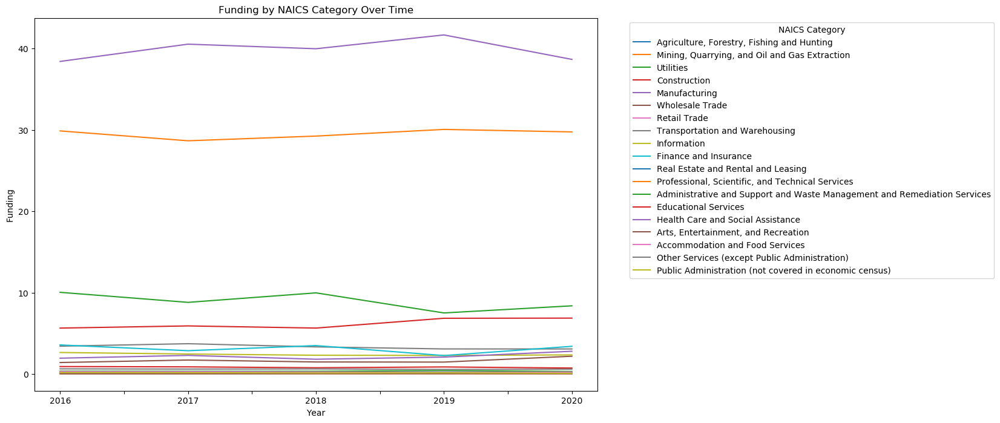

In [4]:
import pandas as pd
import matplotlib.pyplot as plt

# Read CSV file
df = pd.read_csv('us_funding_time_series.csv', index_col=0)

# Plot line chart for each category
df.T.plot(kind='line', figsize=(12,8))

# Add title and labels
plt.title('Funding by NAICS Category Over Time')
plt.xlabel('Year')
plt.ylabel('Funding')
plt.legend(title='NAICS Category', bbox_to_anchor=(1.05, 1), loc='upper left')

# Show chart
plt.show()


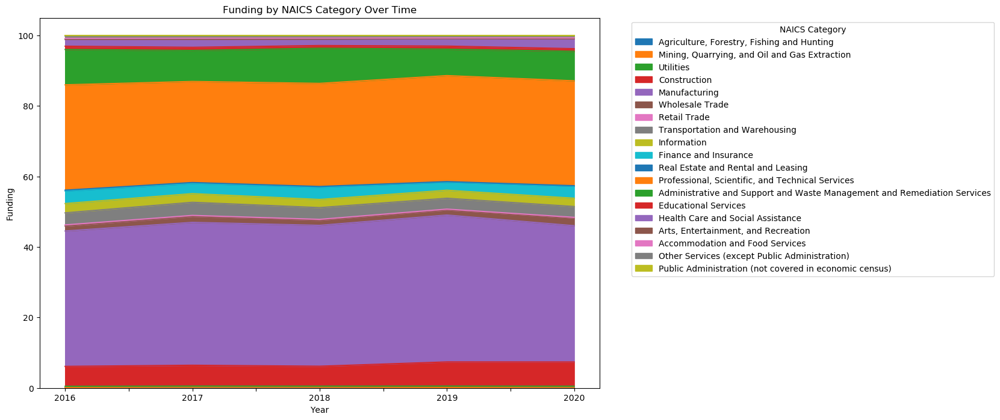

In [5]:
import pandas as pd
import matplotlib.pyplot as plt

# Read CSV file
df = pd.read_csv('us_funding_time_series.csv', index_col=0)

# Plot stacked area chart
df.T.plot(kind='area', stacked=True, figsize=(12,8))

# Add title and labels
plt.title('Funding by NAICS Category Over Time')
plt.xlabel('Year')
plt.ylabel('Funding')
plt.legend(title='NAICS Category', bbox_to_anchor=(1.05, 1), loc='upper left')

# Show chart
plt.show()


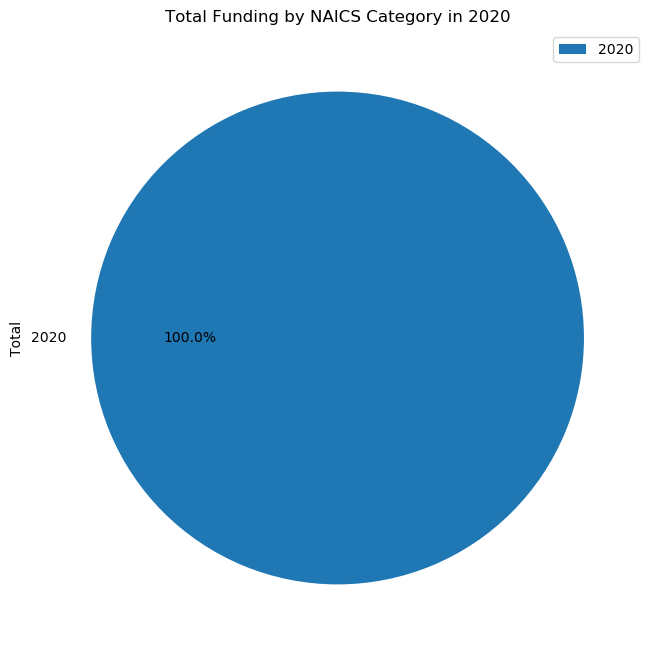

In [7]:
import pandas as pd
import matplotlib.pyplot as plt

# Read CSV file
df = pd.read_csv('us_funding_time_series.csv', index_col=0)

# Filter for 2020 and sum across categories
df_2020 = df[['2020']].T
df_2020['Total'] = df_2020.sum(axis=1)

# Plot pie chart
df_2020.plot(kind='pie', y='Total', figsize=(12,8), autopct='%1.1f%%')

# Add title and labels
plt.title('Total Funding by NAICS Category in 2020')

# Show chart
plt.show()


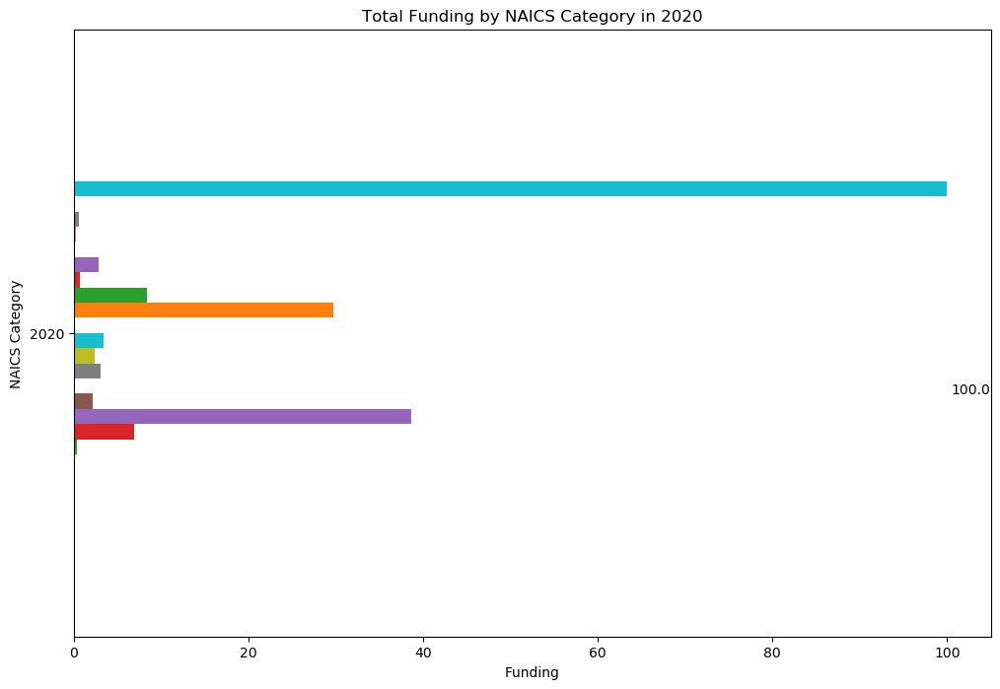

In [6]:
import pandas as pd
import matplotlib.pyplot as plt

# Read CSV file
df = pd.read_csv('us_funding_time_series.csv', index_col=0)

# Filter for 2020 and sum across categories
df_2020 = df[['2020']].T
df_2020['Total'] = df_2020.sum(axis=1)

# Plot horizontal bar chart
ax = df_2020.plot(kind='barh', legend=False, figsize=(12,8))

# Add values to bars
for i, v in enumerate(df_2020['Total']):
    ax.text(v + 0.5, i - 0.1, str(round(v, 2)), color='black')

# Add title and labels
plt.title('Total Funding by NAICS Category in 2020')
plt.xlabel('Funding')
plt.ylabel('NAICS Category')

# Show chart
plt.show()


In [72]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Read CSV file
df = pd.read_csv('us_funding_time_series.csv', index_col=0)

# Create stacked area chart using Plotly
fig = make_subplots(rows=1, cols=1, shared_xaxes=True, vertical_spacing=1)
for i, col in enumerate(df.columns):
    fig.add_trace(go.Scatter(
        x=df.index,
        y=df[col],
        mode='lines+markers',
        stackgroup='one',
        name=col
    ), row=1, col=1)

# Set layout and axis labels
fig.update_layout(
    title='Funding by NAICS Category Over Time',
    xaxis_title='Category',
    yaxis_title='Percentage',
    hovermode='x unified',
    legend_title='Year',
    height=600,
    width=1200,
    yaxis_type='log'
)

# Show chart
fig.show()


In [86]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Read CSV file
df = pd.read_csv('us_expenditure_time_series.csv', index_col=0)

# Create stacked area chart using Plotly
fig = make_subplots(rows=1, cols=1, shared_xaxes=True, vertical_spacing=1)
for i, col in enumerate(df.columns):
    fig.add_trace(go.Scatter(
        x=df.index,
        y=df[col],
        mode='lines+markers',
        stackgroup='one',
        name=col
    ), row=1, col=1)

# Set layout and axis labels
fig.update_layout(
    title='Funding by NAICS Category Over Time',
    xaxis_title='Category',
    yaxis_title='Percentage',
    hovermode='x unified',
    legend_title='Year',
    height=600,
    width=1200,
    yaxis_type='log'
)

# Show chart
fig.show()

In [30]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Read CSV file
df = pd.read_csv('us_funding_time_series.csv', index_col=0)

# Create stacked area chart using Plotly
fig = make_subplots(rows=1, cols=1, shared_xaxes=True, vertical_spacing=1, horizontal_spacing=1)
for i, year in enumerate(df.index):
    fig.add_trace(go.Scatter(
        x=[year] * len(df.columns),  # Use year as x-axis data for each category
        y=df.loc[year],
        mode='lines',
        stackgroup='one',
        name=str(year)
    ), row=1, col=1)


# Set layout and axis labels
fig.update_layout(
    title='Funding by NAICS Category Over Time',
    xaxis_title='Year',
    yaxis_title='Funding',
    hovermode='x unified',
    legend_title='NAICS Category'
)

# Show chart
fig.show()

print(df.columns)

Index(['2016', '2017', '2018', '2019', '2020'], dtype='object')


In [11]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Read CSV file
df = pd.read_csv('us_funding_time_series.csv', index_col=0)

# Create stacked area chart using Plotly
fig = make_subplots(rows=1, cols=1, shared_xaxes=True, vertical_spacing=0.02)

# Add trace for each column
for col in df.columns:
    fig.add_trace(
        go.Scatter(
            x=df.index,
            y=df[col],
            mode='lines',
            stackgroup='one',
            name=col
        ), 
        row=1, col=1
    )

# Define the dropdown menu for years
dropdown_options = [
    {'label': year, 'value': year} for year in df.index.astype(str)
]

# Add dropdown menu for years
fig.update_layout(
    title='Funding by NAICS Category Over Time',
    xaxis_title='Year',
    yaxis_title='Funding',
    hovermode='x unified',
    legend_title='NAICS Category',
    updatemenus=[
        {
            'buttons': [
                {
                    'method': 'update',
                    'args': [
                        {'visible': [df.index.astype(str).tolist().index(year) == i for i in range(len(df))]},
                        {'title': f'Funding by NAICS Category in {year}'}
                    ],
                    'label': year
                } for year in df.index.astype(str)
            ],
            'direction': 'down',
            'showactive': True,
            'x': 0.1,
            'y': 1.1
        }
    ]
)

# Show chart
fig.show()


In [31]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Read CSV file
df = pd.read_csv('us_funding_time_series.csv', index_col=0)

# Create stacked area chart using Plotly
fig = make_subplots(rows=1, cols=1, shared_xaxes=True)

# Add trace for each category
for col in df.columns:
    fig.add_trace(go.Scatter(
        x=df.index,
        y=df[col],
        mode='lines',
        name=col
    ), row=1, col=1)

# Set layout and axis labels
fig.update_layout(
    title='Funding by NAICS Category Over Time',
    xaxis_title='Year',
    yaxis_title='Funding',
    hovermode='x unified'
)

# Show chart
fig.show()


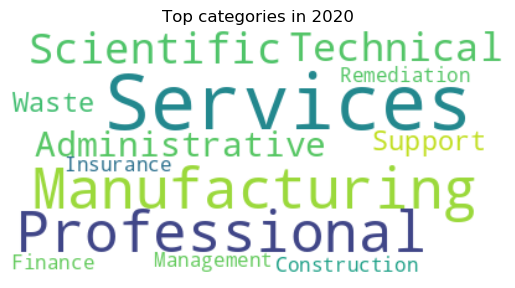

In [54]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# load the data
df = pd.read_csv('us_funding_time_series.csv')

# iterate over the years and get the top 10 categories for each year
for year in range(2016, 2021):
    # select rows where funding for the given year is not null
    not_null_rows = df.loc[df[f"{year}"].notnull()]

# sort the not-null rows by funding percentage in descending order and select the top 5 categories
top_5_categories = not_null_rows.sort_values(by=f"{year}", ascending=False).head(5)

# extract the category names as a list
category_list = top_5_categories["NAICS Category"].tolist()

# assign the category list to the variable top_categories
top_categories = category_list

# combine the category names into a single string
text = ' '.join(['"'+cat+'"' for cat in top_categories])

# generate the word cloud
wordcloud = WordCloud(background_color="white").generate(text)

# plot the word cloud
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.title(f"Top categories in {year}")
plt.show()


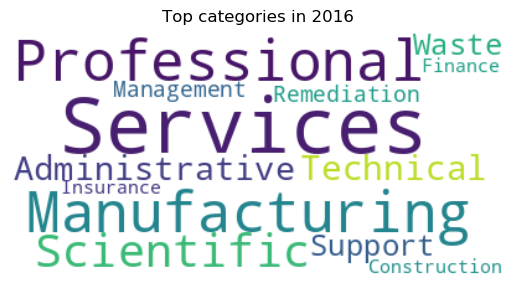

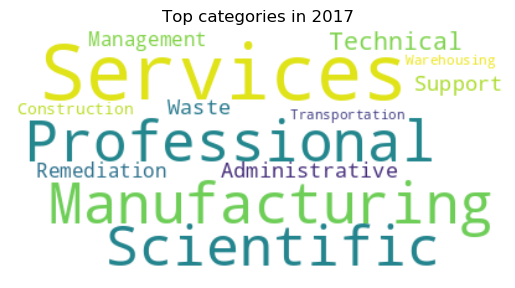

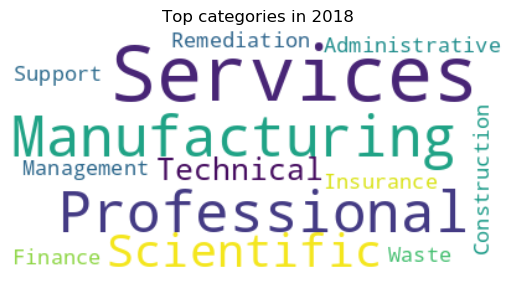

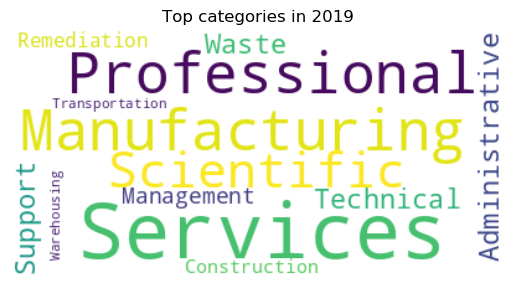

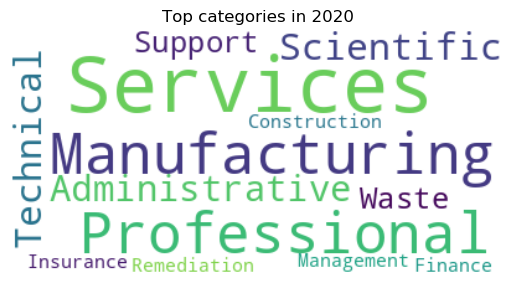

In [97]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# load the data
df = pd.read_csv('us_funding_time_series.csv')

# iterate over the years and get the top 10 categories for each year
for year in range(2016, 2021):
    # select rows where funding for the given year is not null
    not_null_rows = df.loc[df[f"{year}"].notnull()]

    # sort the not-null rows by funding percentage in descending order and select the top 5 categories
    top_5_categories = not_null_rows.sort_values(by=f"{year}", ascending=False).head(5)

    # extract the category names as a list
    category_list = top_5_categories["NAICS Category"].tolist()

    # assign the category list to the variable top_categories
    top_categories = category_list
    
    # combine the category names into a single string
    text = ' '.join(top_categories)
    
    # generate the word cloud
    wordcloud = WordCloud(background_color="white").generate(text)
    
    # plot the word cloud
    plt.figure()
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Top categories in {year}")
    plt.show()


Manufacturing Professional, Scientific, and Technical  Administrative and Support and Waste Management and Remediation  Construction Finance and Insurance


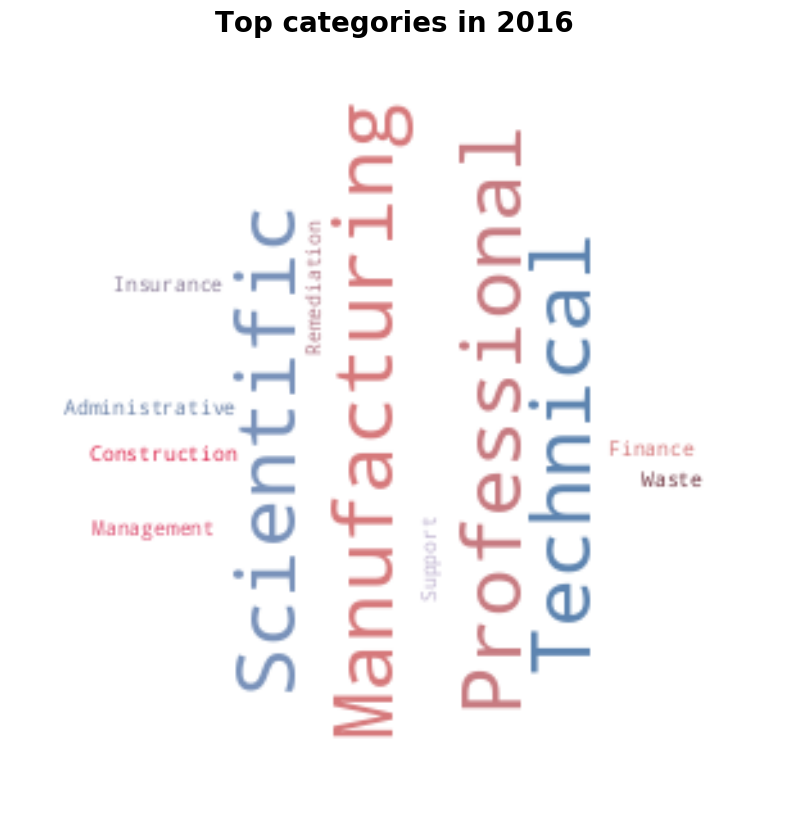

Manufacturing Professional, Scientific, and Technical  Administrative and Support and Waste Management and Remediation  Construction Transportation and Warehousing


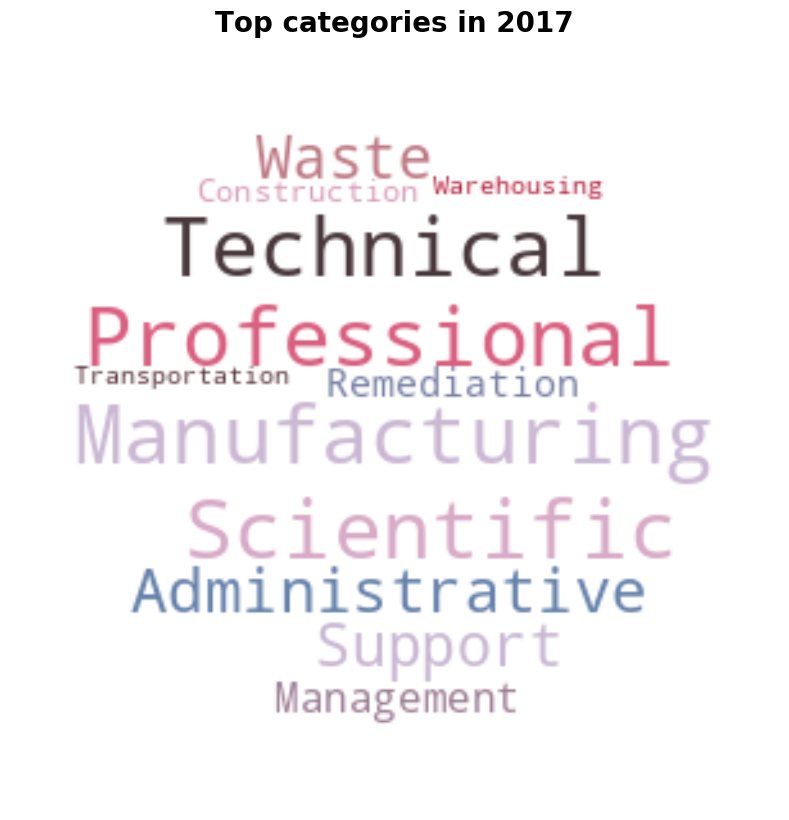

Manufacturing Professional, Scientific, and Technical  Administrative and Support and Waste Management and Remediation  Construction Finance and Insurance


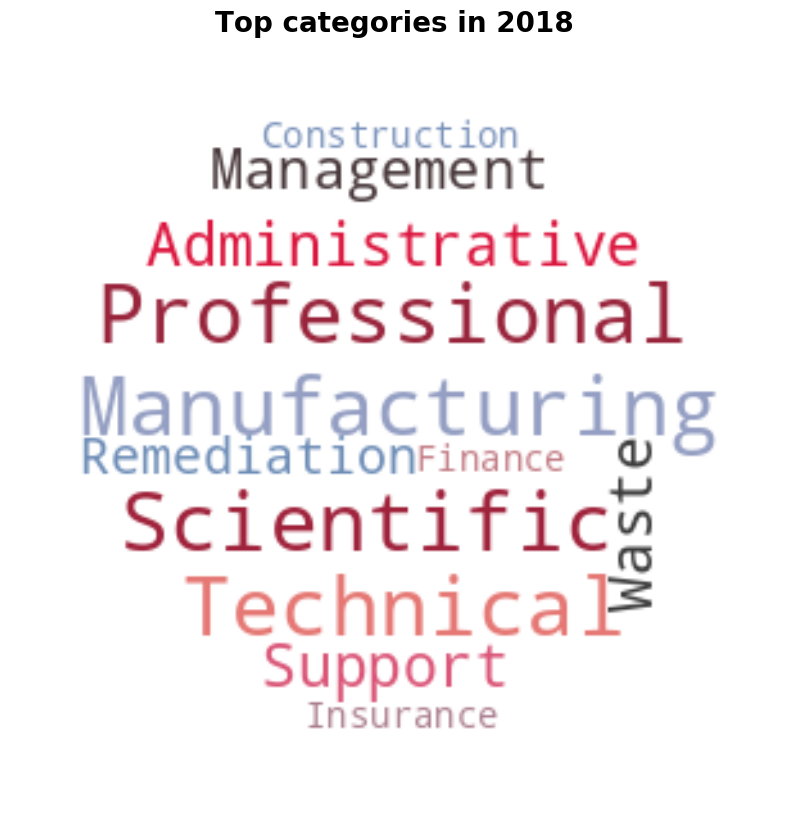

Manufacturing Professional, Scientific, and Technical  Administrative and Support and Waste Management and Remediation  Construction Transportation and Warehousing


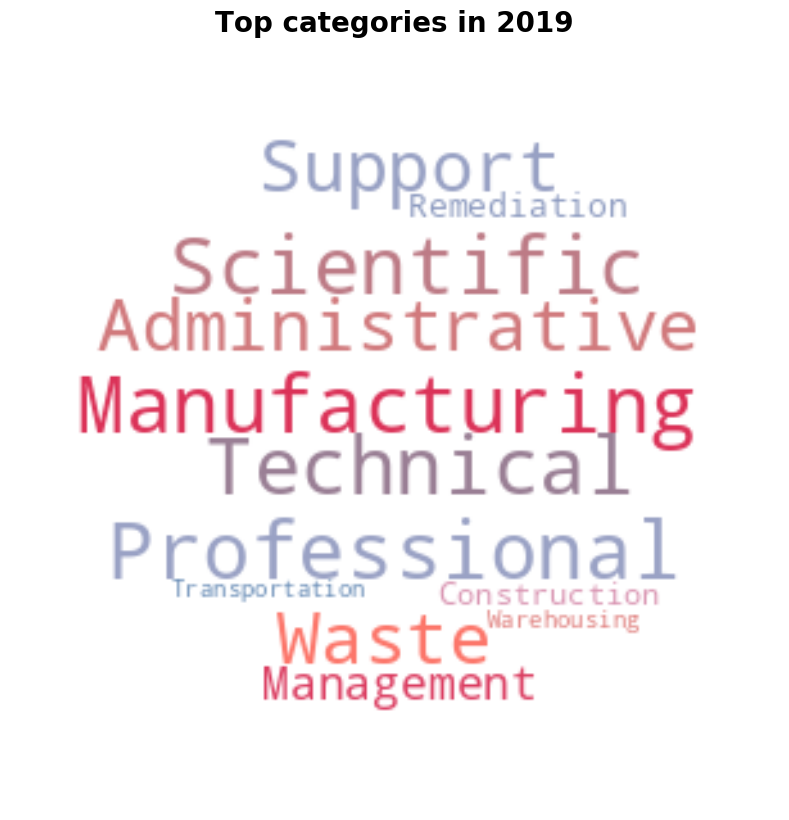

Manufacturing Professional, Scientific, and Technical  Administrative and Support and Waste Management and Remediation  Construction Finance and Insurance


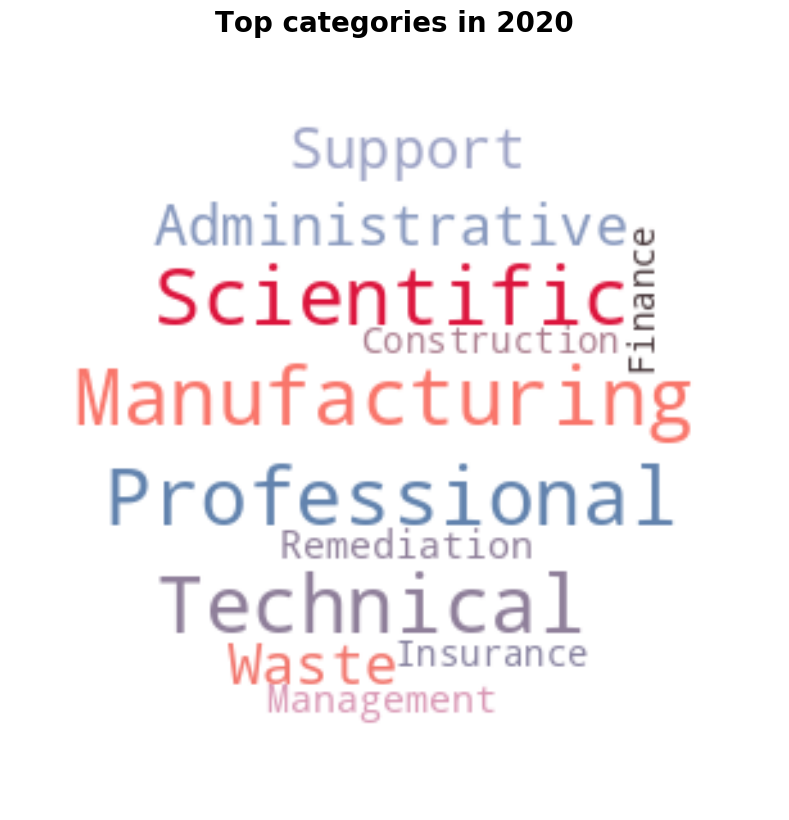

In [70]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors

# load the data
df = pd.read_csv('us_funding_time_series.csv')

# define a custom color map
# colors = ['red', 'orange', 'yellow', 'green', 'blue', 'purple']
# color_map = mcolors.ListedColormap(colors)

# define the Meranti color system as a list of hex color codes
meranti_colors = ['#FC766AFF', '#5B84B1FF', '#D8BFD8FF', '#DC143CFF', '#3C3C3CFF']

# convert the hex color codes to RGB values
meranti_colors_rgb = [mcolors.hex2color(color) for color in meranti_colors]

# create a custom color map using the RGB values
meranti_cmap = mcolors.LinearSegmentedColormap.from_list('meranti', meranti_colors_rgb)

# define a custom word cloud shape
x, y = np.ogrid[:300, :300]
mask = (x - 150) ** 2 + (y - 150) ** 2 > 130 ** 2
mask = 255 * mask.astype(int)

# iterate over the years and get the top 10 categories for each year
for year in range(2016, 2021):
    # select rows where funding for the given year is not null
    not_null_rows = df.loc[df[f"{year}"].notnull()]

    # sort the not-null rows by funding percentage in descending order and select the top 5 categories
    top_5_categories = not_null_rows.sort_values(by=f"{year}", ascending=False).head(5)

    # extract the category names as a list
    category_list = top_5_categories["NAICS Category"].tolist()

    # combine the category names into a single string
    text = ' '.join(category_list)
    text = text.replace("Services", "")
    print(text)

    # create a word cloud object with custom color map and mask
    wordcloud = WordCloud(background_color="white", colormap=meranti_cmap, mask=mask).generate(text)

    # plot the word cloud
    plt.figure(figsize=(8, 8))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Top categories in {year}", fontsize=20, fontweight='bold')
    plt.tight_layout(pad=0)
    plt.show()


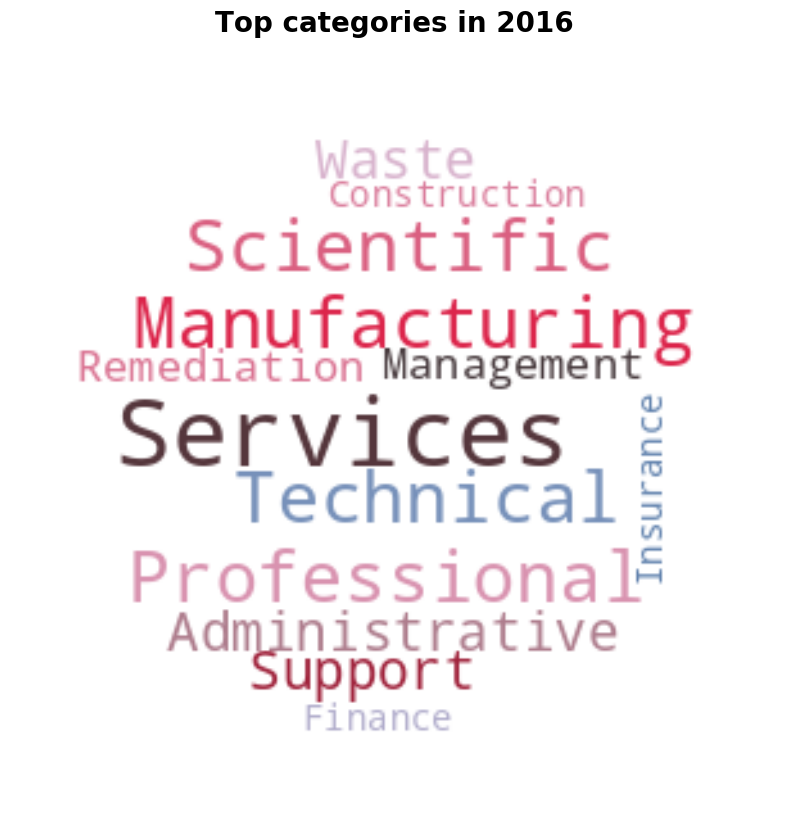

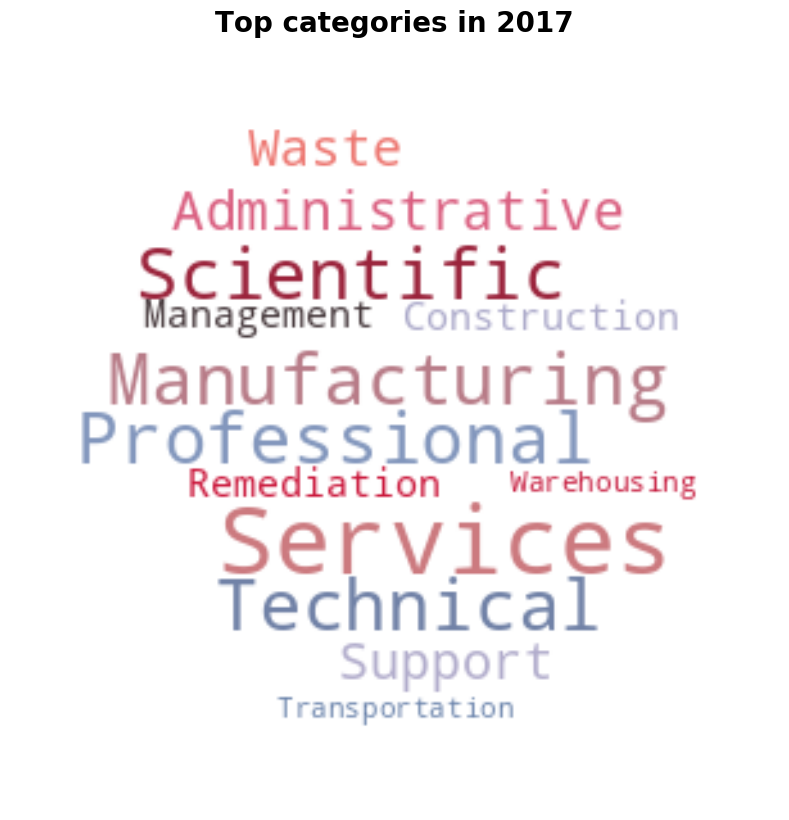

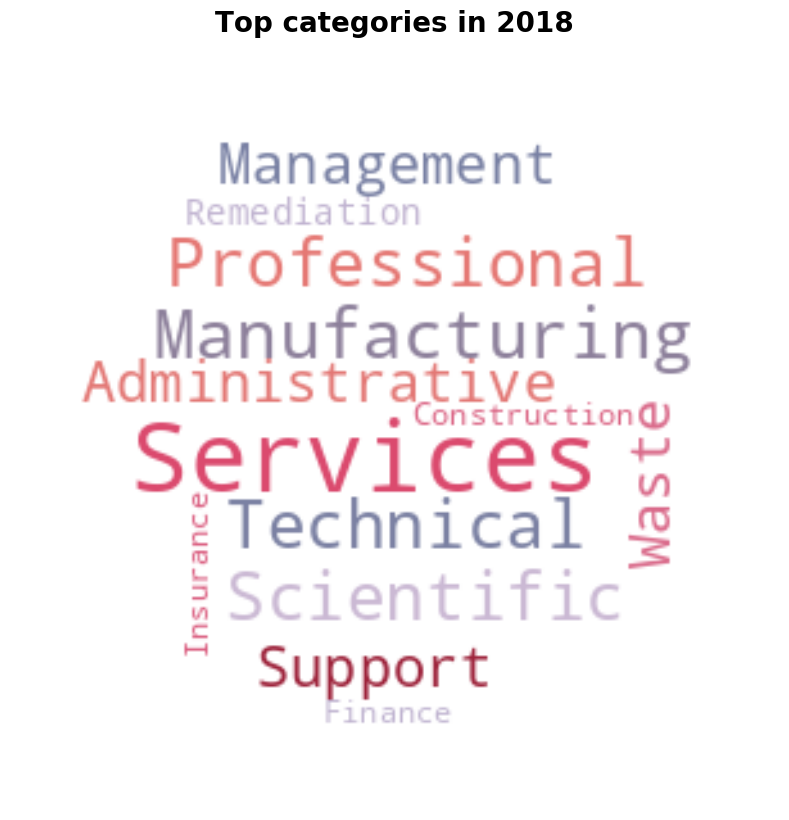

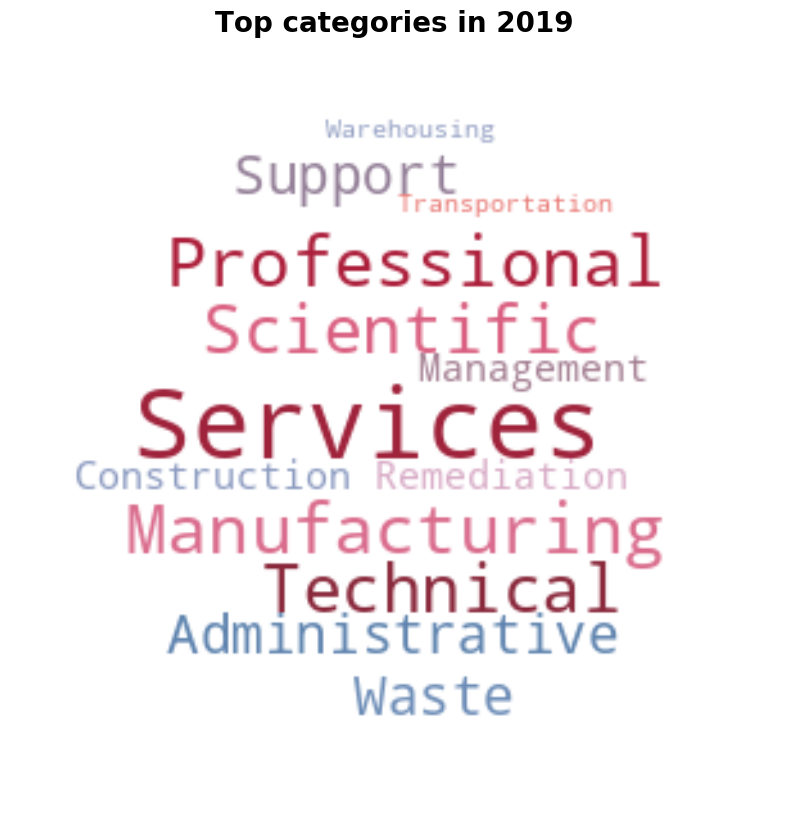

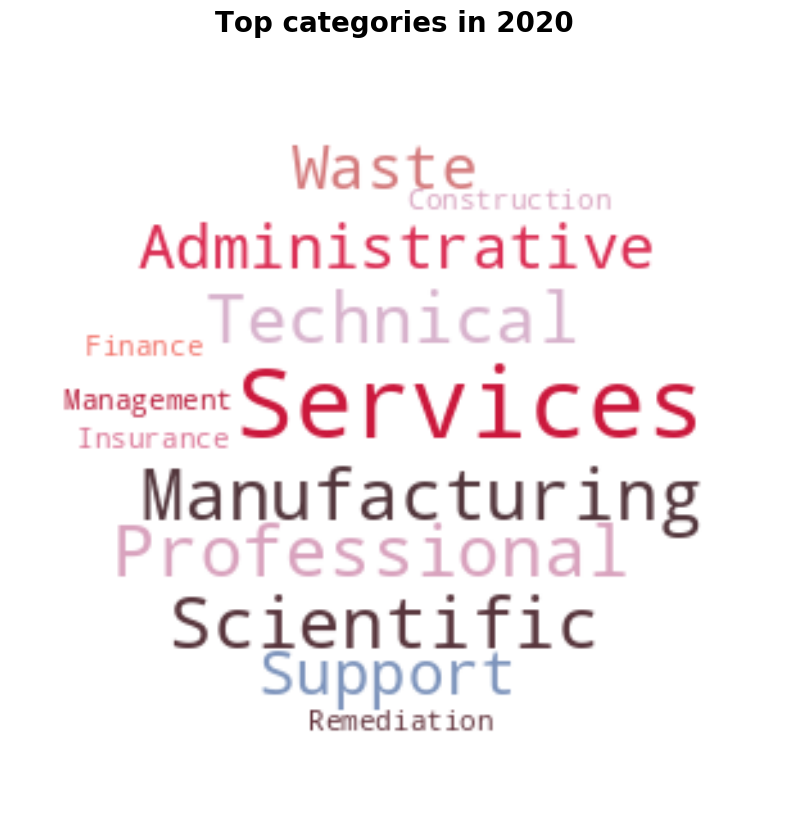

In [69]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors

# load the data
df = pd.read_csv('us_funding_time_series.csv')

# define a custom color map
meranti_colors = ['#FC766AFF', '#5B84B1FF', '#D8BFD8FF', '#DC143CFF', '#3C3C3CFF']
meranti_colors_rgb = [mcolors.hex2color(color) for color in meranti_colors]
meranti_cmap = mcolors.LinearSegmentedColormap.from_list('meranti', meranti_colors_rgb)

# define a custom word cloud shape
x, y = np.ogrid[:300, :300]
mask = (x - 150) ** 2 + (y - 150) ** 2 > 130 ** 2
mask = 255 * mask.astype(int)

# iterate over the years and get the top 10 categories for each year
for year in range(2016, 2021):
    # select rows where funding for the given year is not null
    not_null_rows = df.loc[df[f"{year}"].notnull()]

    # sort the not-null rows by funding percentage in descending order and select the top 5 categories
    top_8_categories = not_null_rows.sort_values(by=f"{year}", ascending=False).head(8)

    # extract the category names as a list, filter out any category containing "service", and join them with double quotes to ensure they stay as a whole
    category_list = [f'"{name}"' for name in top_8_categories["NAICS Category"].tolist()]

    # combine the category names into a single string
    text = ' '.join(category_list)

    # create a word cloud object with custom color map and mask
    wordcloud = WordCloud(background_color="white", colormap=meranti_cmap, mask=mask).generate(text)

    # plot the word cloud
    plt.figure(figsize=(8, 8))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Top categories in {year}", fontsize=20, fontweight='bold')
    plt.tight_layout(pad=0)
    plt.show()


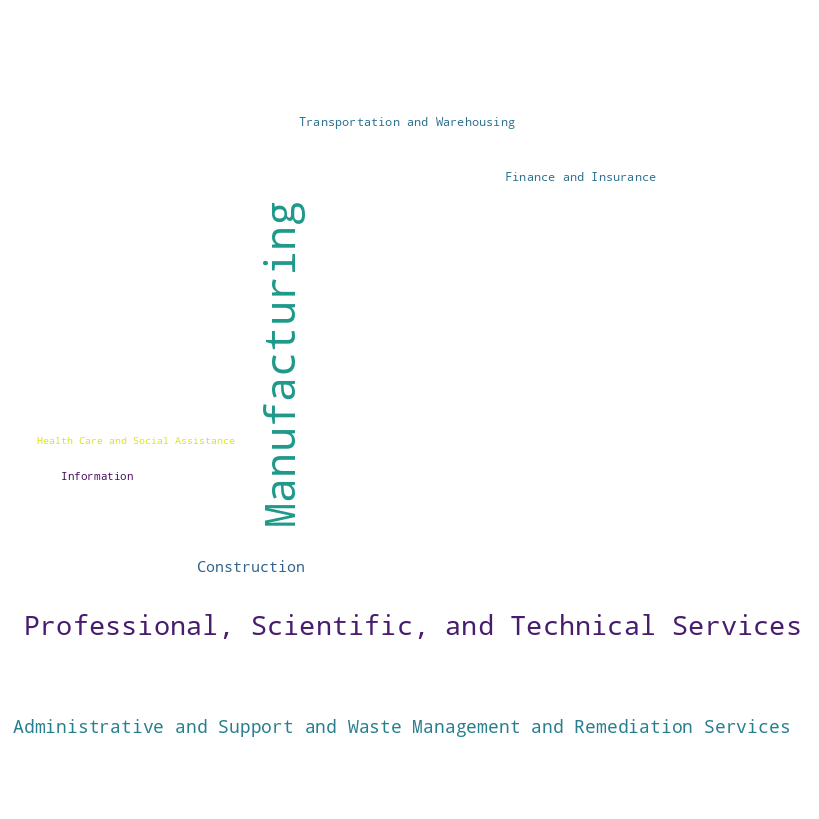

In [72]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# read the csv file
df = pd.read_csv('us_funding_time_series.csv')

# create a dictionary that contains the NAICS category as the key and the sum of the funding percentage for all years as the value
category_weight = {}
for index, row in df.iterrows():
    category = row['NAICS Category']
    weight = sum(row[1:])
    category_weight[category] = weight

# create a word cloud object and generate the word cloud using the dictionary
wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='white', 
                min_font_size = 10).generate_from_frequencies(category_weight)

# plot the word cloud using matplotlib
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
plt.show() 


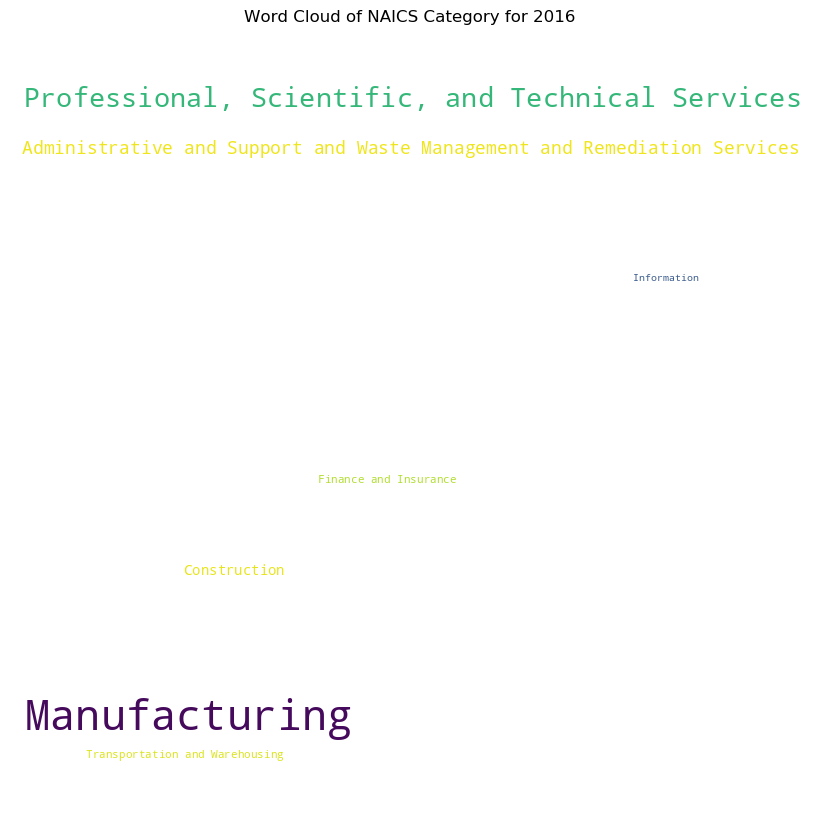

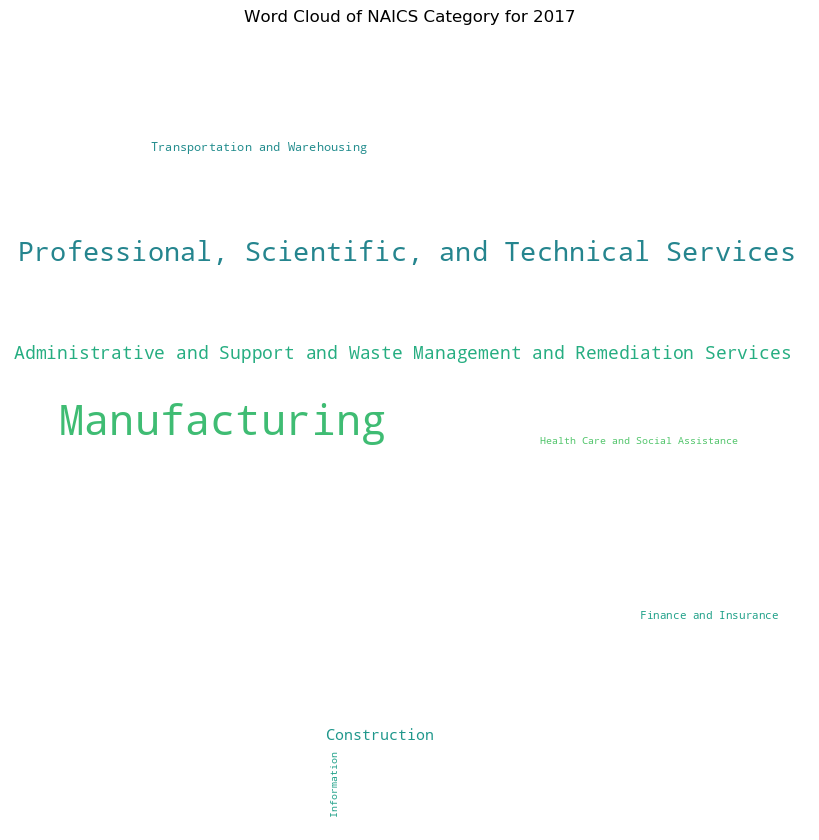

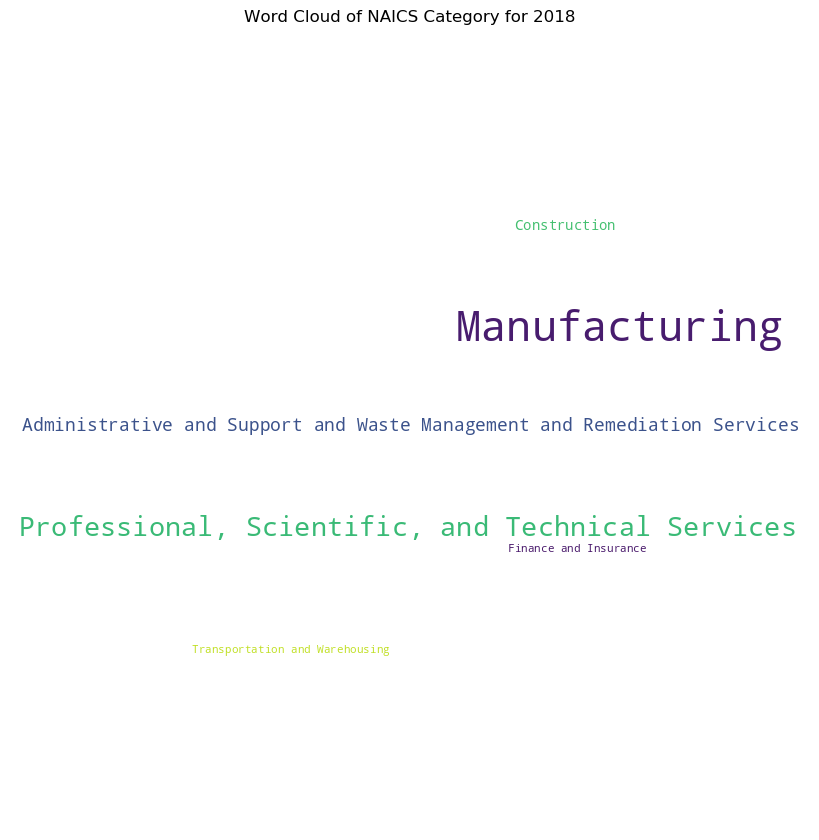

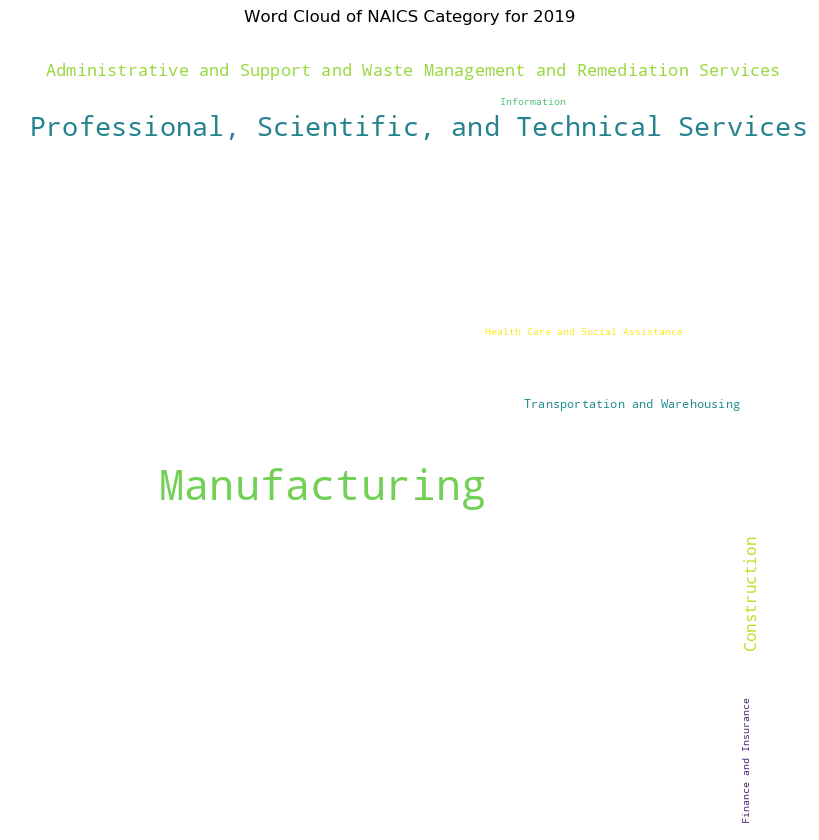

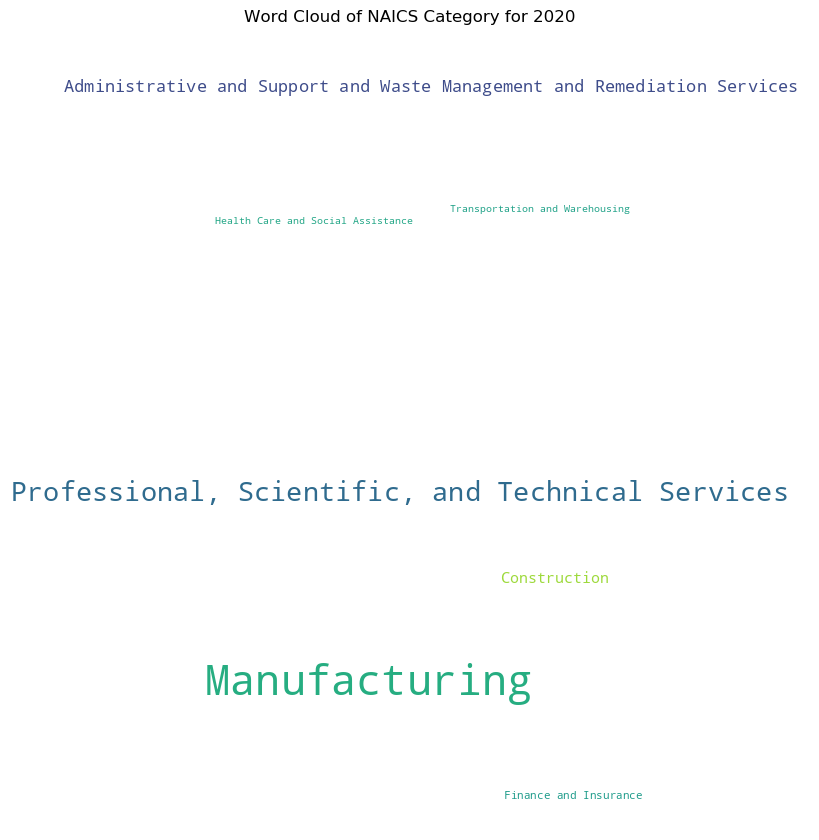

In [77]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# read the csv file
df = pd.read_csv('us_funding_time_series.csv')

# loop through the years
for year in range(2016, 2021):
    # create a dictionary that contains the NAICS category as the key and the funding percentage for the current year as the value
    category_weight = {}
    for index, row in df.iterrows():
        category = row['NAICS Category']
        weight = row[str(year)]
        category_weight[category] = weight

    # create a word cloud object and generate the word cloud using the dictionary
    wordcloud = WordCloud(width = 800, height = 800, 
                    background_color ='white', 
                    min_font_size = 10).generate_from_frequencies(category_weight)

    # plot the word cloud using matplotlib
    plt.figure(figsize = (8, 8), facecolor = None) 
    plt.imshow(wordcloud) 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(f"Word Cloud of NAICS Category for {year}") # add a title
    plt.show()


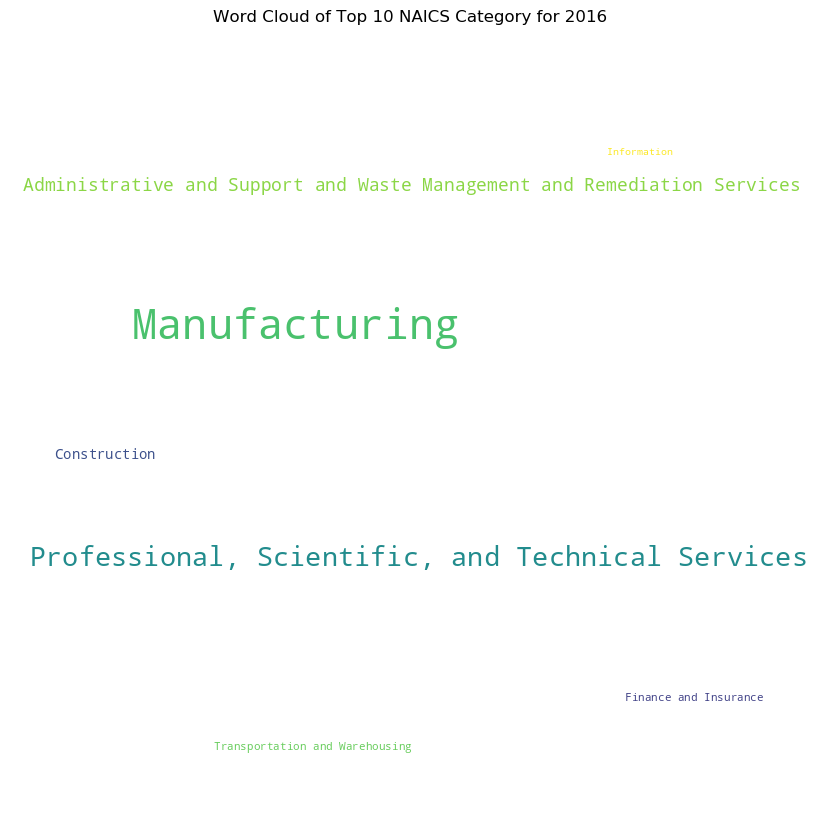

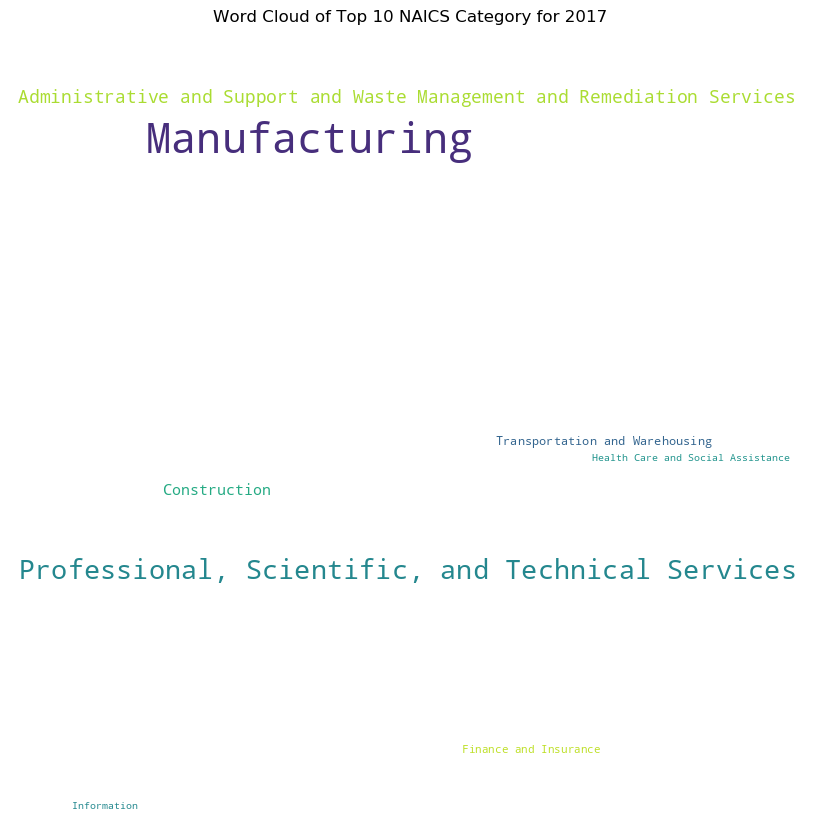

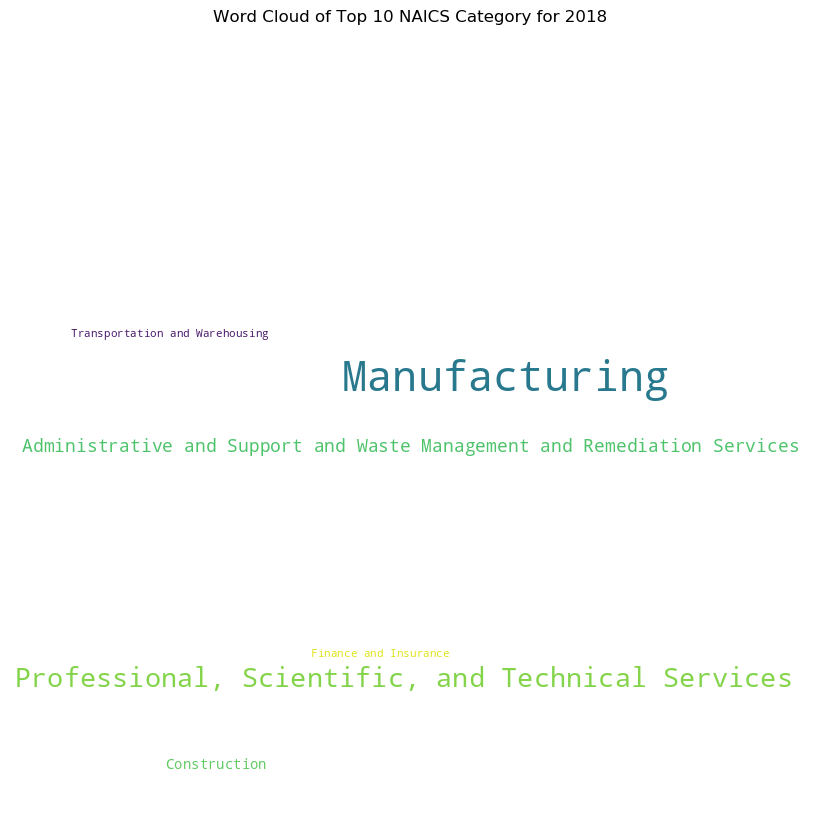

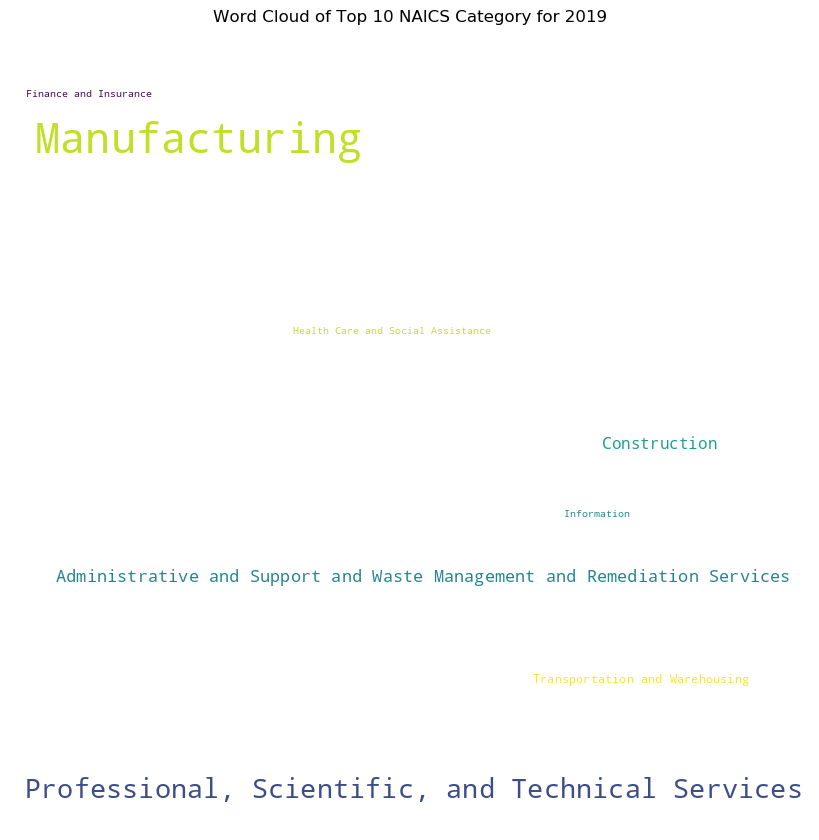

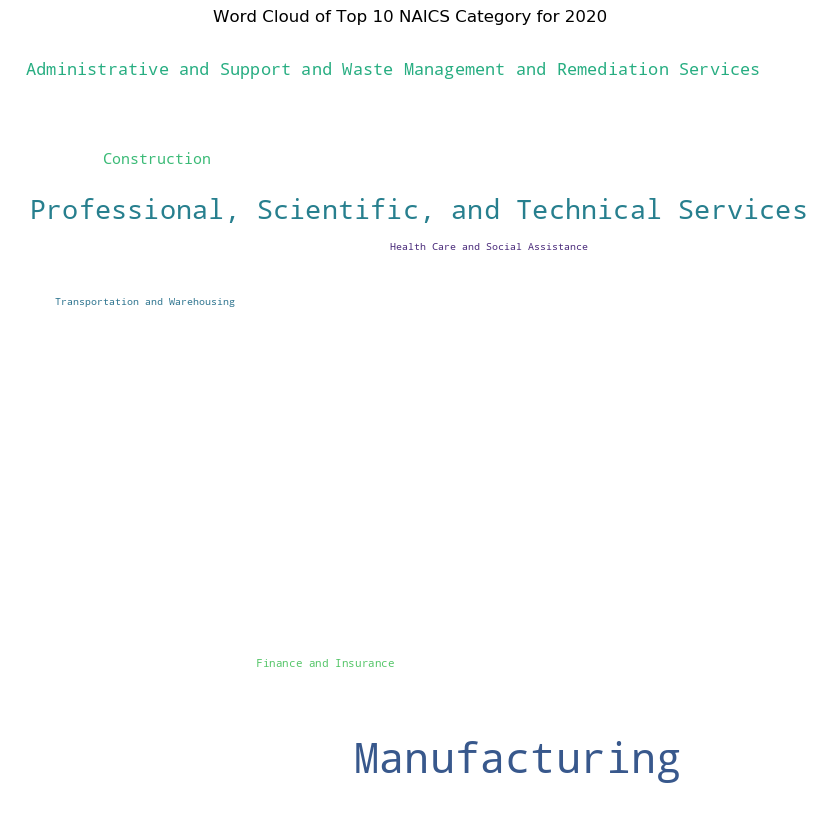

In [90]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# read the csv file
df = pd.read_csv('us_funding_time_series.csv')

# loop through the years
for year in range(2016, 2021):
    # create a dictionary that contains the NAICS category as the key and the funding percentage for the current year as the value
    category_weight = {}
    for index, row in df.iterrows():
        category = row['NAICS Category']
        weight = row[str(year)]
        category_weight[category] = weight

    # sort the dictionary by value in descending order and select the top 10 categories
    top_categories = dict(sorted(category_weight.items(), key=lambda item: item[1], reverse=True)[:10])

    # create a word cloud object and generate the word cloud using the dictionary
    wordcloud = WordCloud(width = 800, height = 800, 
                    background_color ='white', 
                    min_font_size = 10,
                    max_words = 50, # limit the number of words
                   ).generate_from_frequencies(top_categories)

    # plot the word cloud using matplotlib
    plt.figure(figsize = (8, 8), facecolor = None) 
    plt.imshow(wordcloud, aspect='auto') # use equal aspect ratio to prevent stretching
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(f"Word Cloud of Top 10 NAICS Category for {year}") # add a title
    plt.show()


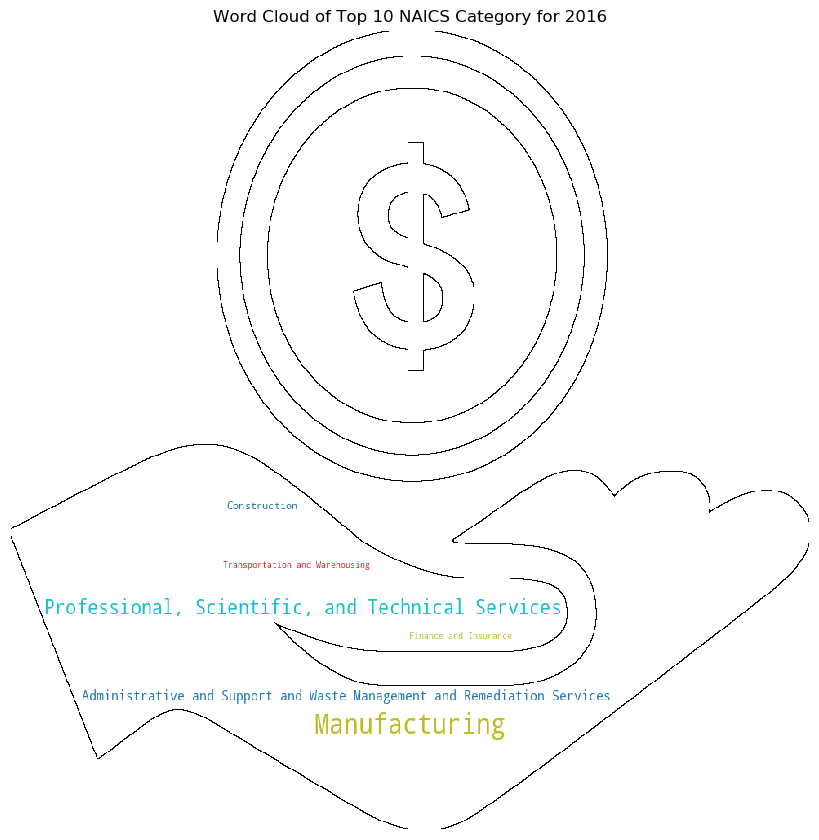

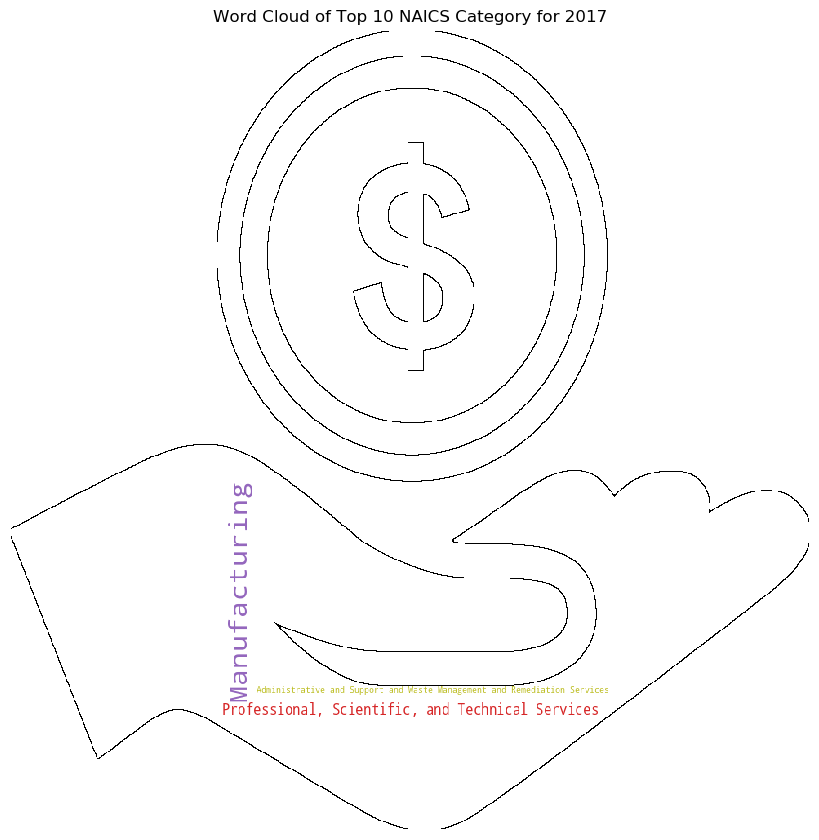

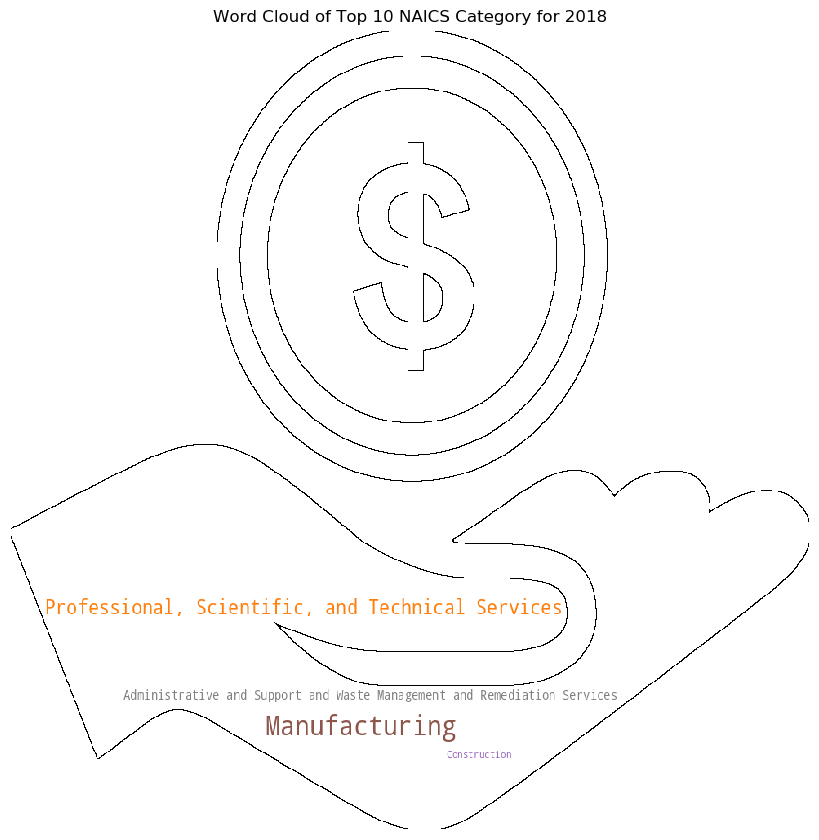

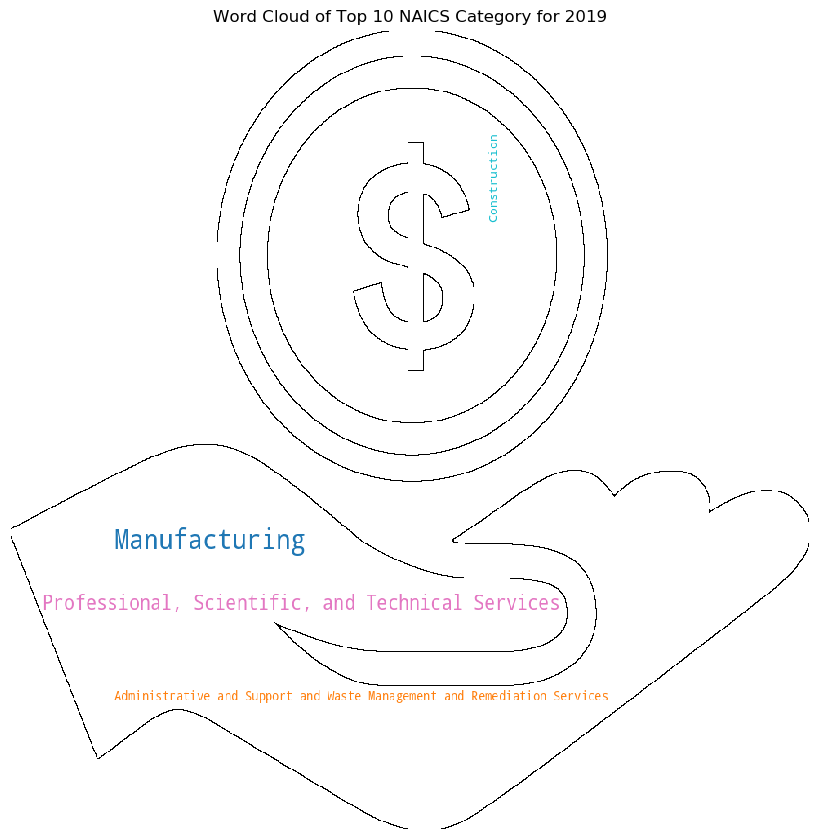

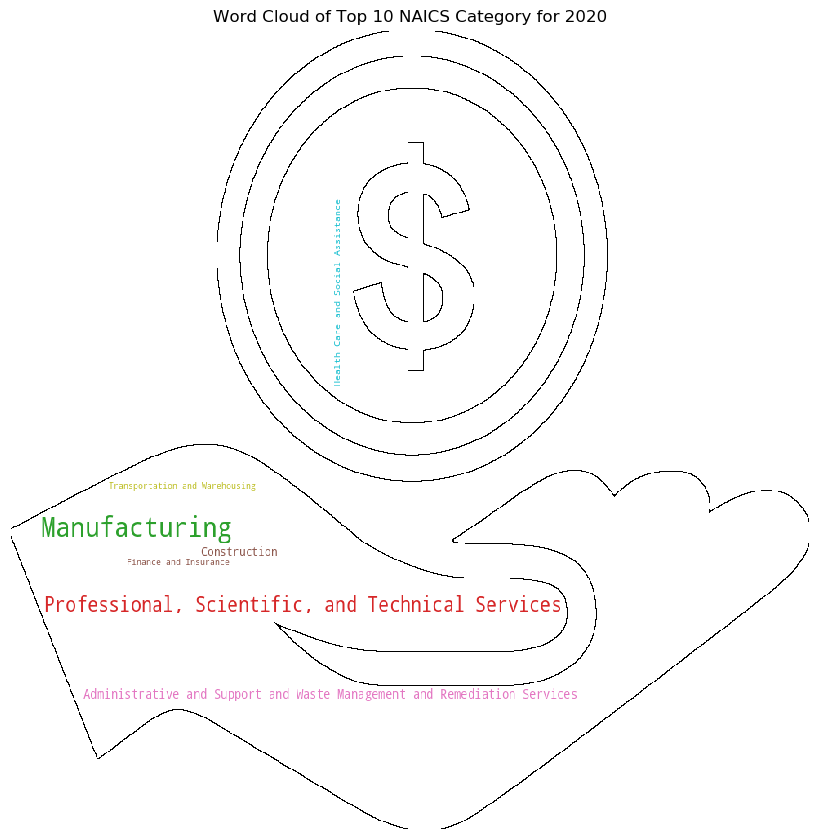

In [107]:
import pandas as pd
from wordcloud import WordCloud, ImageColorGenerator
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

# read the csv file
df = pd.read_csv('us_funding_time_series.csv')

# load the funding image
funding_mask = np.array(Image.open("Funding.png"))

# loop through the years
for year in range(2016, 2021):
    # create a dictionary that contains the NAICS category as the key and the funding percentage for the current year as the value
    category_weight = {}
    for index, row in df.iterrows():
        category = row['NAICS Category']
        weight = row[str(year)]
        category_weight[category] = weight

    # sort the dictionary by value in descending order and select the top 10 categories
    top_categories = dict(sorted(category_weight.items(), key=lambda item: item[1], reverse=True)[:10])

    # create a word cloud object and generate the word cloud using the dictionary and the funding image as the mask
    wordcloud = WordCloud(width = 800, height = 800, 
                    background_color ='white', 
                    min_font_size = 10,
                    max_words = 50, # limit the number of words
                    mask = funding_mask, # use the funding image as the mask
                    contour_width=1, # add contour lines to the text
                    contour_color='black', # set contour line color
                    colormap='tab10' # set color palette
                   ).generate_from_frequencies(top_categories)

    # plot the word cloud using matplotlib
    plt.figure(figsize = (8, 8), facecolor = None) 
    plt.imshow(wordcloud, aspect='auto') # use equal aspect ratio to prevent stretching
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(f"Word Cloud of Top 10 NAICS Category for {year}") # add a title
    plt.show()


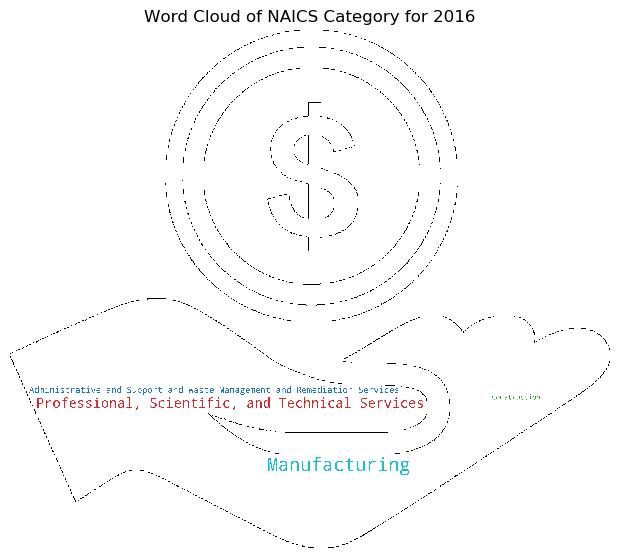

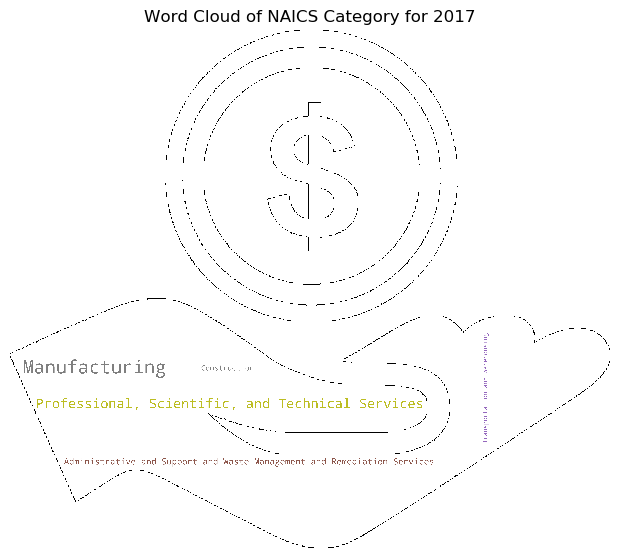

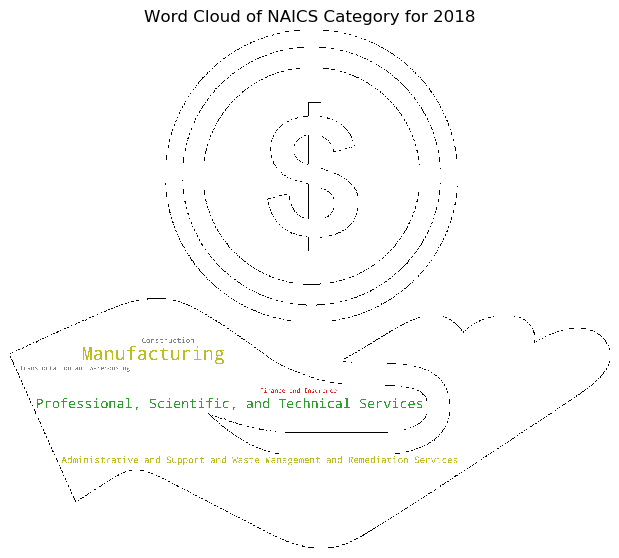

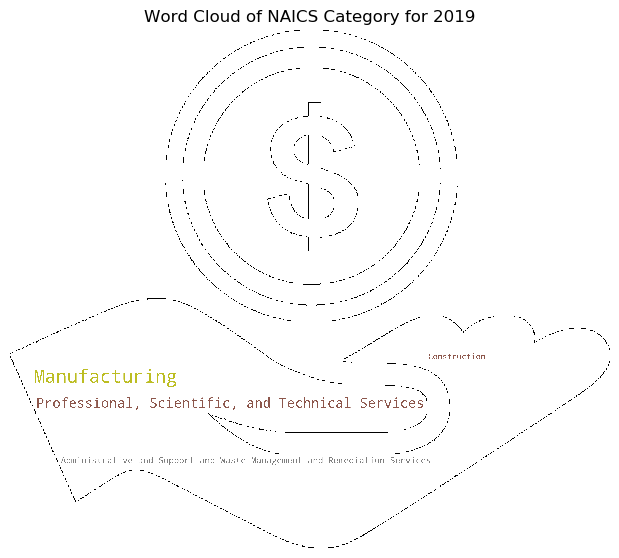

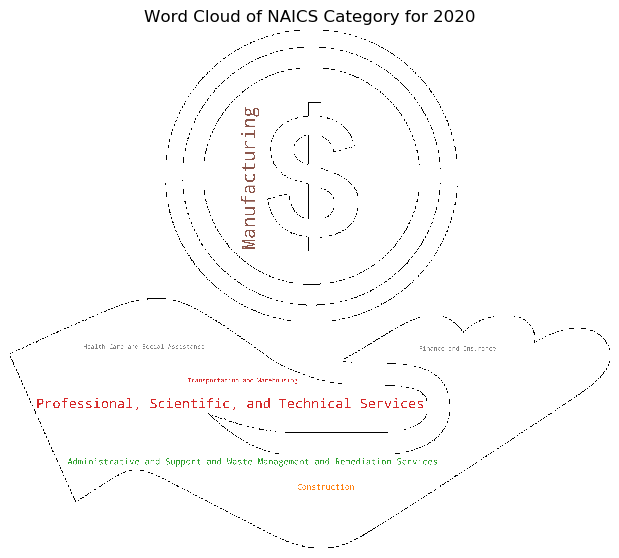

In [114]:
import pandas as pd
from wordcloud import WordCloud, ImageColorGenerator
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

# read the csv file
df = pd.read_csv('us_funding_time_series.csv')

# load the funding image
funding_mask = np.array(Image.open("Funding.png"))

# loop through the years
for year in range(2016, 2021):
    # create a dictionary that contains the NAICS category as the key and the funding percentage for the current year as the value
    category_weight = {}
    for index, row in df.iterrows():
        category = row['NAICS Category']
        weight = row[str(year)]
        category_weight[category] = weight

    # create a word cloud object and generate the word cloud using the dictionary and the funding image as the mask
    wordcloud = WordCloud(width = 800, height = 800, 
                    background_color ='white', 
                    min_font_size = 10,
                    max_words = 50, # limit the number of words
                    mask = funding_mask, # use the funding image as the mask
                    contour_width=5, # add contour lines to the text
                    contour_color='black', # set contour line color
                    colormap='tab10', # set color palette
                    scale=10
                   ).generate_from_frequencies(category_weight)

    # plot the word cloud using matplotlib
    plt.figure(figsize = (6, 6), facecolor = None) 
    plt.imshow(wordcloud, aspect='equal') # use equal aspect ratio to prevent stretching
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(f"Word Cloud of NAICS Category for {year}") # add a title
    plt.show()


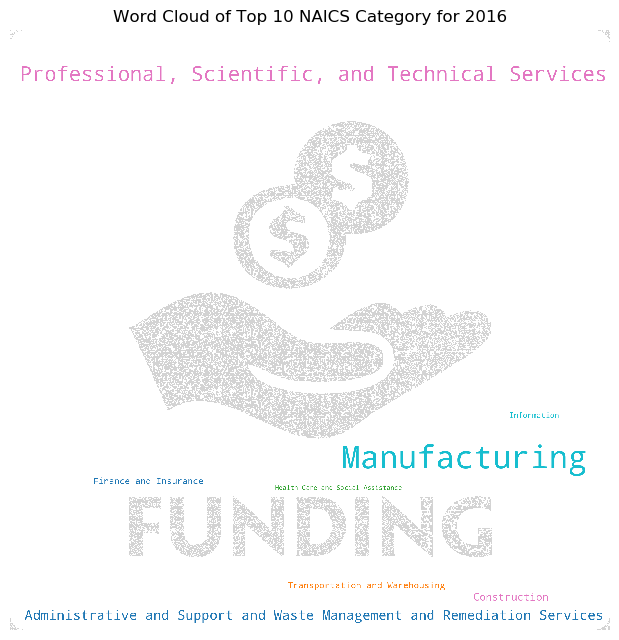

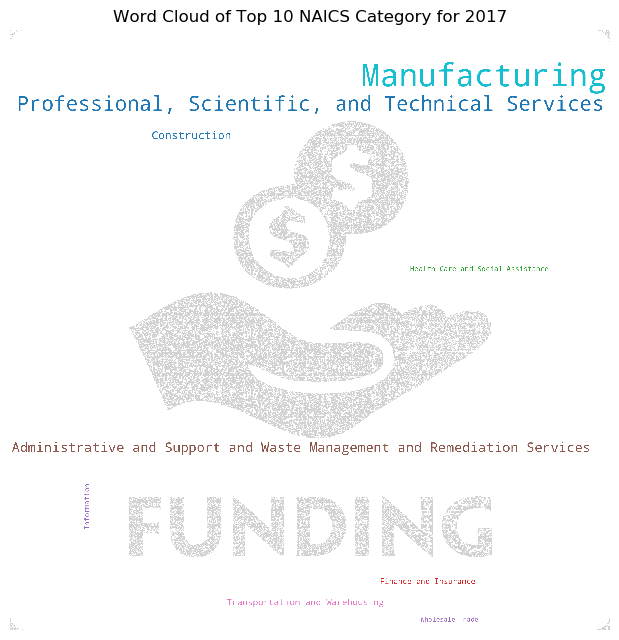

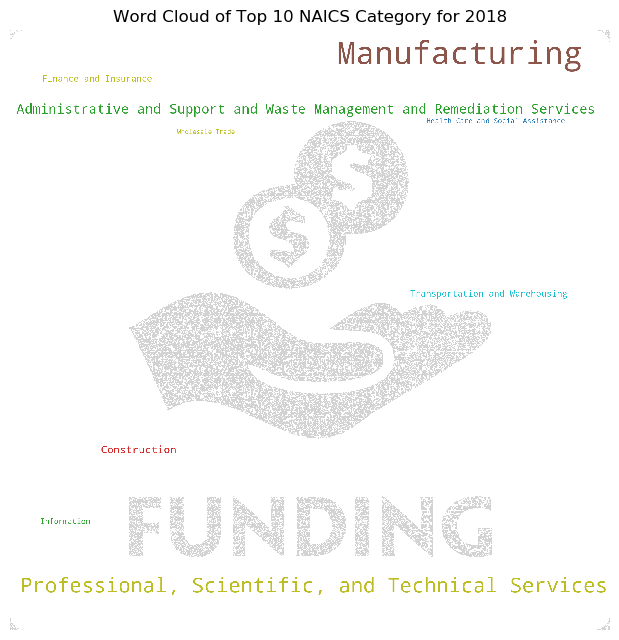

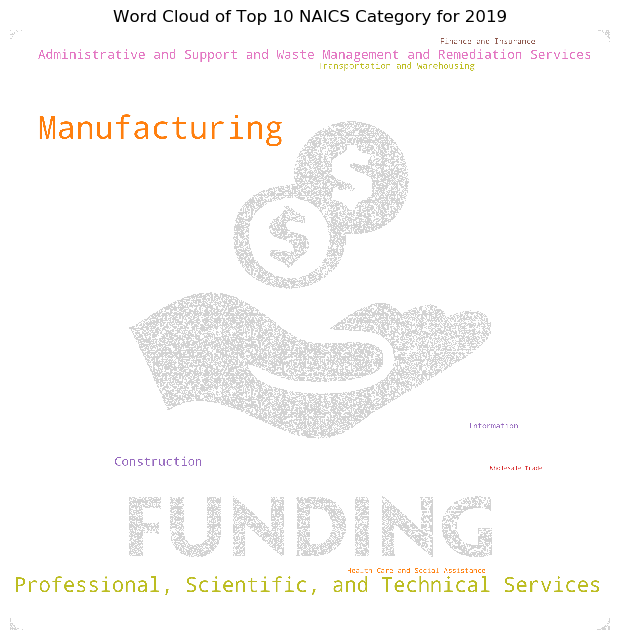

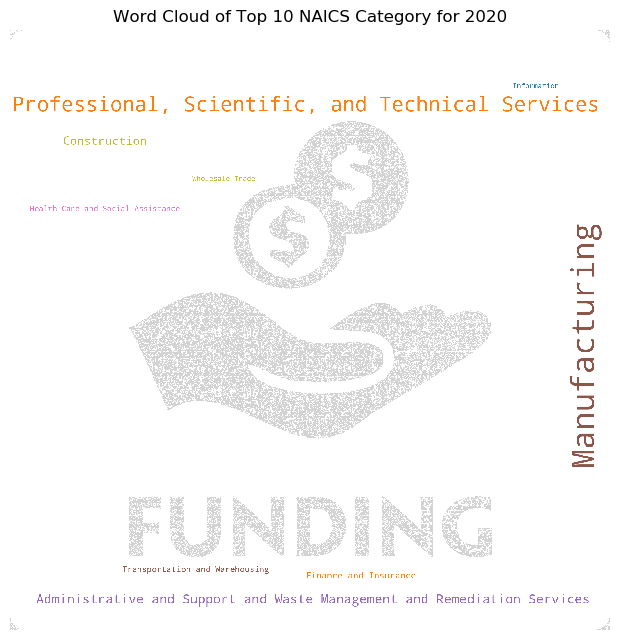

In [137]:
import pandas as pd
from wordcloud import WordCloud, ImageColorGenerator
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

# read the csv file
df = pd.read_csv('us_funding_time_series.csv')

# load the funding image
funding_mask = np.array(Image.open("Funding2.png"))

# loop through the years
for year in range(2016, 2021):
    # create a dictionary that contains the NAICS category as the key and the funding percentage for the current year as the value
    category_weight = {}
    for index, row in df.iterrows():
        category = row['NAICS Category']
        weight = row[str(year)]
        category_weight[category] = weight

    # sort the dictionary by value in descending order and select the top 10 categories
    top_categories = dict(sorted(category_weight.items(), key=lambda item: item[1], reverse=True)[:10])

    # create a word cloud object and generate the word cloud using the dictionary and the funding image as the mask
    wordcloud = WordCloud(width = 800, height = 800, 
                    background_color ='white', 
                    min_font_size = 10,
                    max_words = 50, # limit the number of words
                    mask = funding_mask, # use the funding image as the mask
                    contour_width=1, # add contour lines to the text
                    contour_color='lightgrey', # set contour line color
                    colormap='tab10',
                    scale=2 # set color palette
                   ).generate_from_frequencies(top_categories)

    # plot the word cloud using matplotlib
    plt.figure(figsize = (6, 6), facecolor = None) 
    plt.imshow(wordcloud, aspect='equal') # use equal aspect ratio to prevent stretching
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(f"Word Cloud of Top 10 NAICS Category for {year}") # add a title
    plt.show()


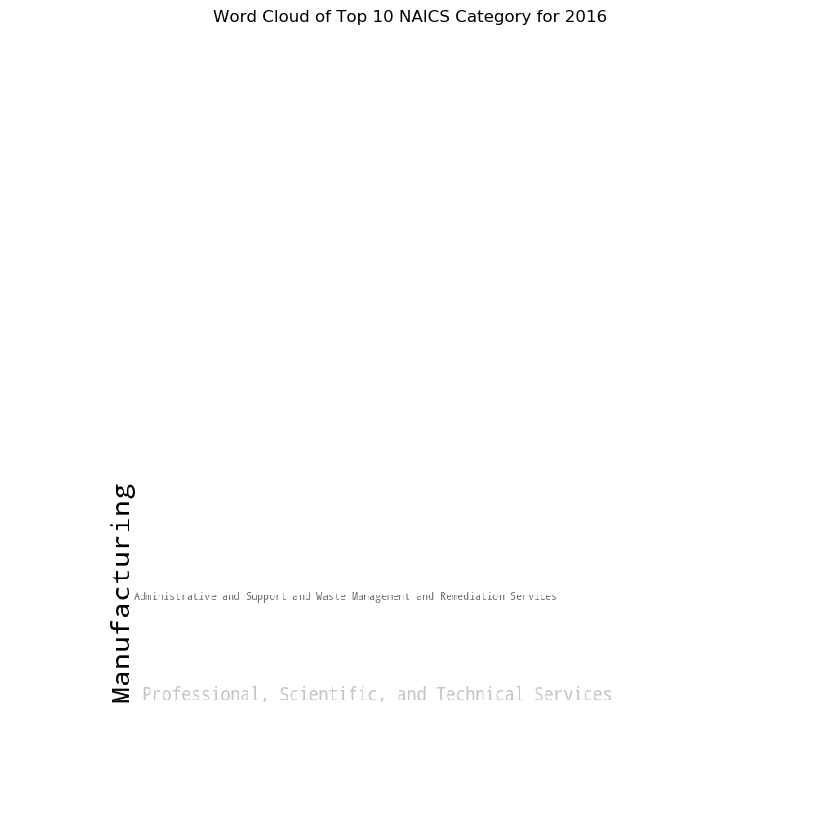

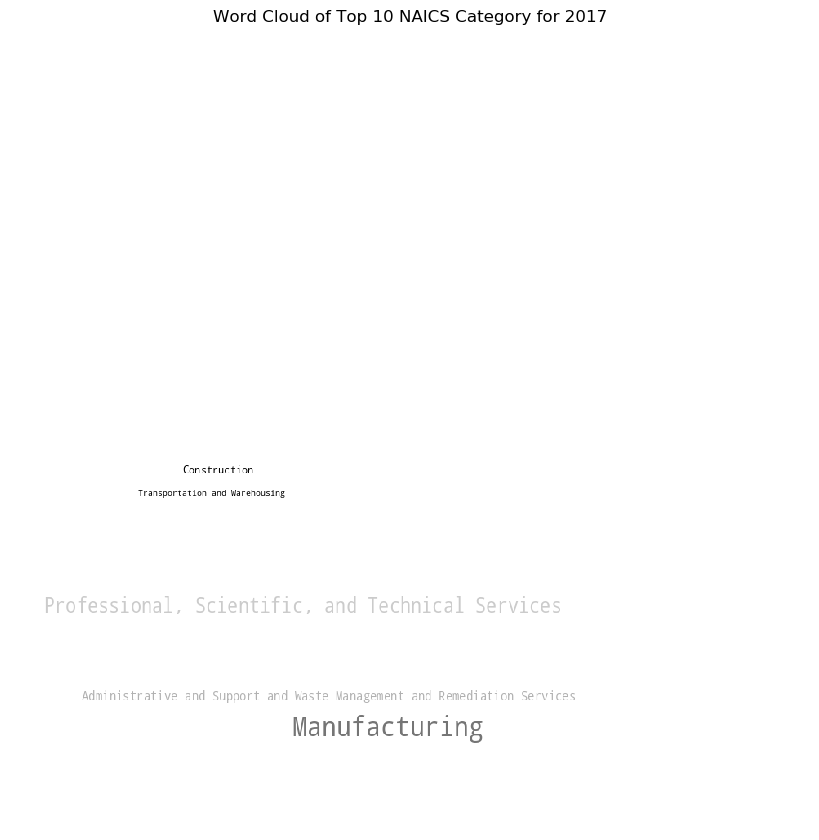

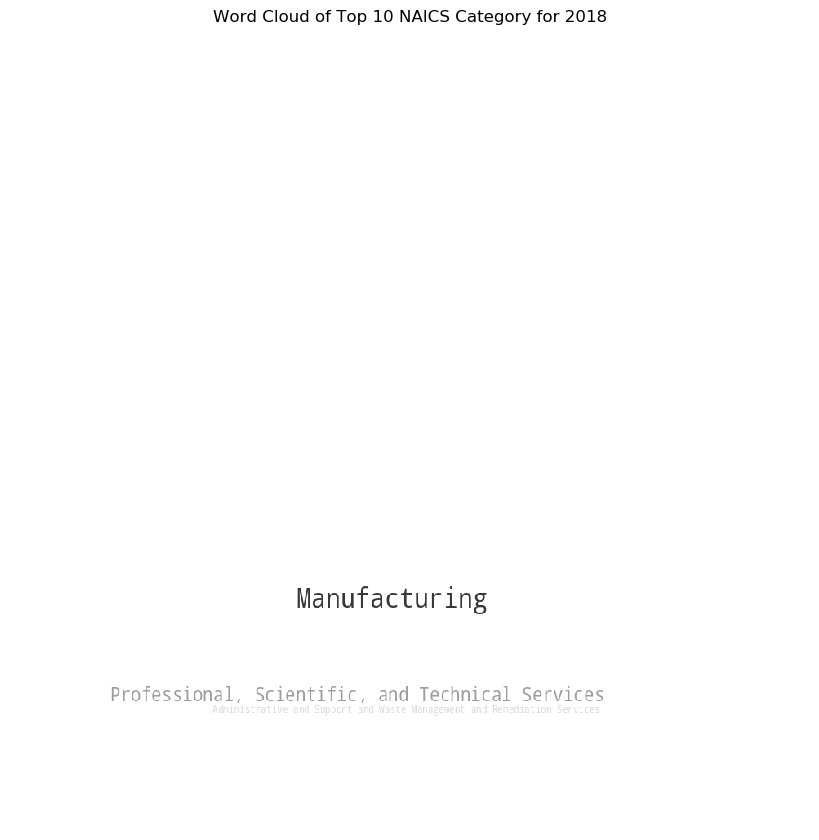

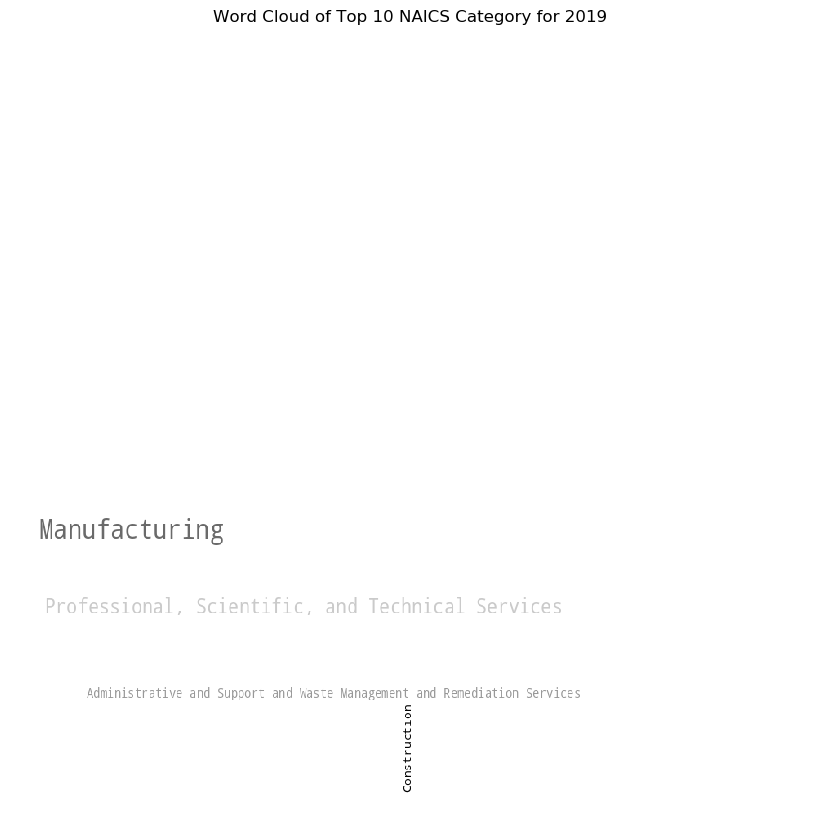

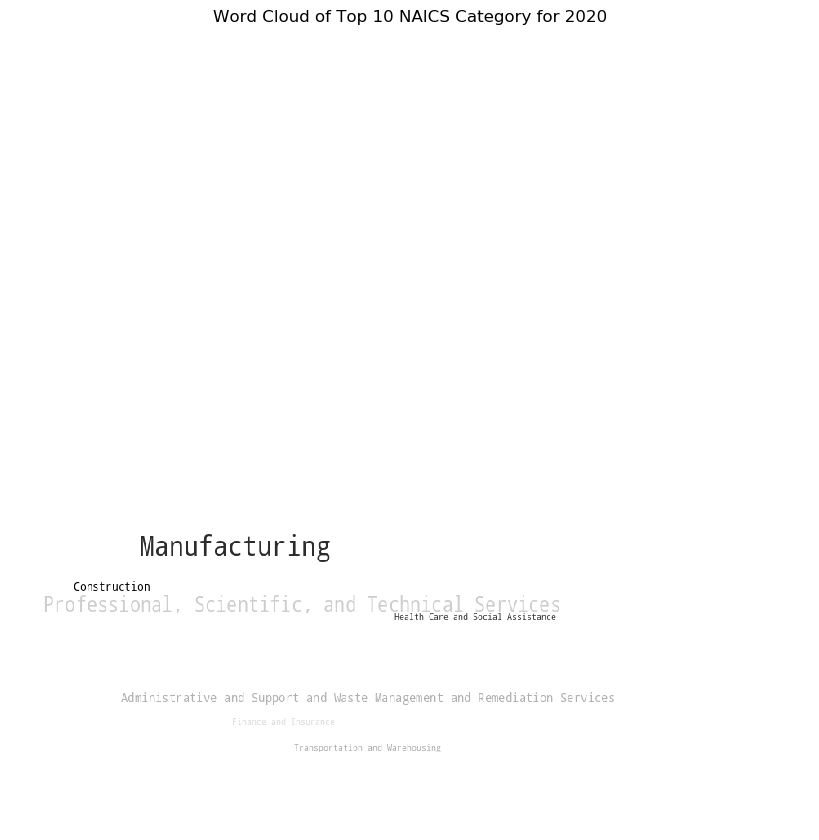

In [99]:
import pandas as pd
from wordcloud import WordCloud, ImageColorGenerator
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

# read the csv file
df = pd.read_csv('us_funding_time_series.csv')

# load the funding image
funding_mask = np.array(Image.open("Funding.png"))

# loop through the years
for year in range(2016, 2021):
    # create a dictionary that contains the NAICS category as the key and the funding percentage for the current year as the value
    category_weight = {}
    for index, row in df.iterrows():
        category = row['NAICS Category']
        weight = row[str(year)]
        category_weight[category] = weight

    # sort the dictionary by value in descending order and select the top 10 categories
    top_categories = dict(sorted(category_weight.items(), key=lambda item: item[1], reverse=True)[:10])

    # create a word cloud object and generate the word cloud using the dictionary and the funding image as the mask
    wordcloud = WordCloud(width = 800, height = 800, 
                    background_color ='white', 
                    min_font_size = 10,
                    max_words = 50, # limit the number of words
                    mask = funding_mask # use the funding image as the mask
                   ).generate_from_frequencies(top_categories)

    # create a color generator from the funding image
    image_colors = ImageColorGenerator(funding_mask)

    # plot the word cloud using matplotlib
    plt.figure(figsize = (8, 8), facecolor = None) 
    plt.imshow(wordcloud.recolor(color_func=image_colors), aspect='auto') # use equal aspect ratio to prevent stretching
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(f"Word Cloud of Top 10 NAICS Category for {year}") # add a title
    plt.show()


{'Agriculture, Forestry, Fishing and Hunting': 0.0982625563241845, 'Mining, Quarrying, and Oil and Gas Extraction': 0.041436651819264, 'Utilities': 0.3444525176762411, 'Construction': 5.643414520370071, 'Manufacturing': 38.41213309117446, 'Wholesale Trade': 1.4104950103570129, 'Retail Trade': 0.3114075141823702, 'Transportation and Warehousing': 3.4184078187005347, 'Information': 2.6438880310647765, 'Finance and Insurance': 3.5703611781998337, 'Real Estate and Rental and Leasing': 0.234919085942145, 'Professional, Scientific, and Technical Services': 29.87339044964227, 'Administrative and Support and Waste Management and Remediation Services': 10.03781036179401, 'Educational Services': 0.9173478928003896, 'Health Care and Social Assistance': 1.9439110860616784, 'Arts, Entertainment, and Recreation': 0.0233502364159288, 'Accommodation and Food Services': 0.2617749706718587, 'Other Services (except Public Administration)': 0.6347698753149407, 'Public Administration (not covered in econom

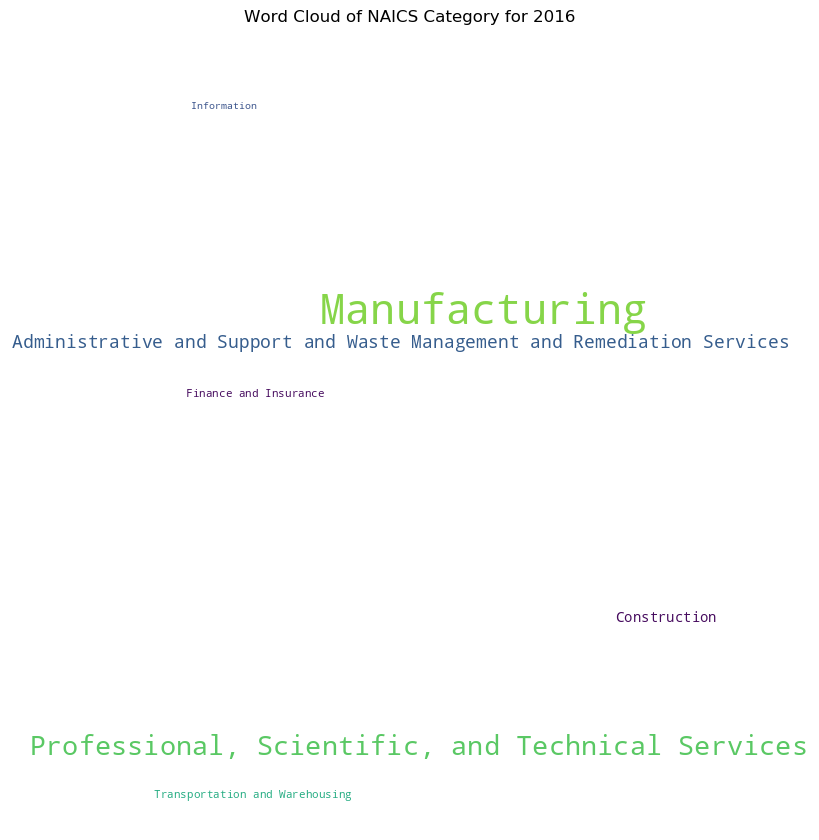

{'Agriculture, Forestry, Fishing and Hunting': 0.1576073259848081, 'Mining, Quarrying, and Oil and Gas Extraction': 0.0460070264371035, 'Utilities': 0.3366462635764417, 'Construction': 5.910579449488446, 'Manufacturing': 40.53508523038929, 'Wholesale Trade': 1.7177522698270549, 'Retail Trade': 0.2499899598576958, 'Transportation and Warehousing': 3.723525785728848, 'Information': 2.456050554438582, 'Finance and Insurance': 2.86486653551866, 'Real Estate and Rental and Leasing': 0.2936702931162531, 'Professional, Scientific, and Technical Services': 28.660762519755085, 'Administrative and Support and Waste Management and Remediation Services': 8.805174973979115, 'Educational Services': 0.87945373737658, 'Health Care and Social Assistance': 2.2864210920529797, 'Arts, Entertainment, and Recreation': 0.0266671837460387, 'Accommodation and Food Services': 0.2791757120963882, 'Other Services (except Public Administration)': 0.606638814939849, 'Public Administration (not covered in economic c

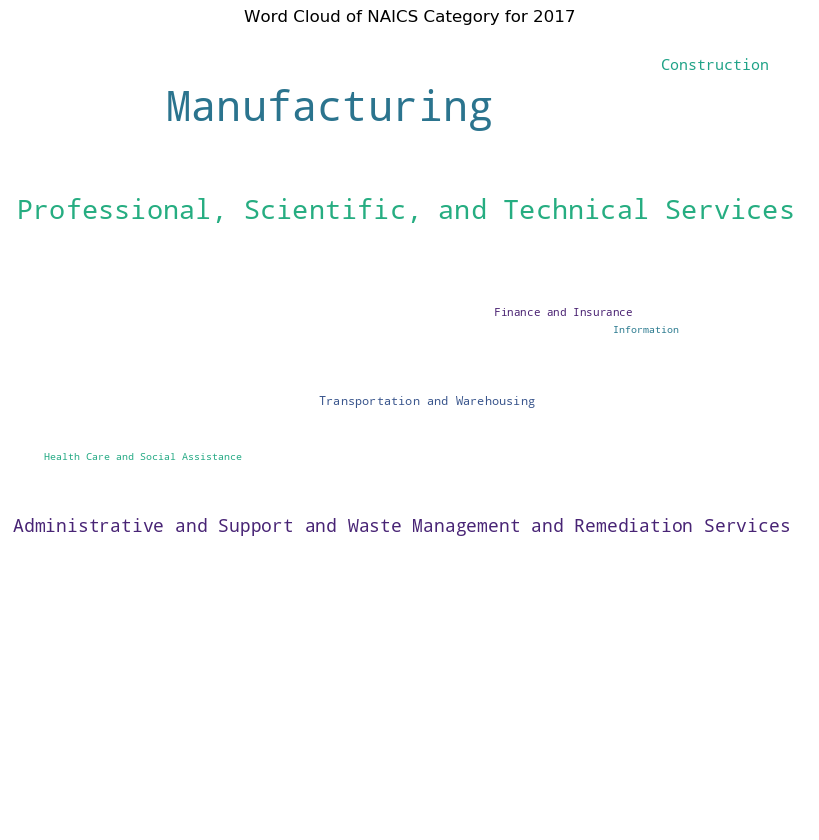

{'Agriculture, Forestry, Fishing and Hunting': 0.1424358819045872, 'Mining, Quarrying, and Oil and Gas Extraction': 0.0469153852232174, 'Utilities': 0.3348054227365985, 'Construction': 5.644671225967455, 'Manufacturing': 39.97104919510739, 'Wholesale Trade': 1.4803187804071063, 'Retail Trade': 0.216310310042694, 'Transportation and Warehousing': 3.334292621819685, 'Information': 2.3047280665451595, 'Finance and Insurance': 3.4910968201394303, 'Real Estate and Rental and Leasing': 0.2007301346825545, 'Professional, Scientific, and Technical Services': 29.239143798925426, 'Administrative and Support and Waste Management and Remediation Services': 9.971360156133136, 'Educational Services': 0.7691027457841209, 'Health Care and Social Assistance': 1.8165390515007336, 'Arts, Entertainment, and Recreation': 0.0369918249929961, 'Accommodation and Food Services': 0.243577049482946, 'Other Services (except Public Administration)': 0.627432805963831, 'Public Administration (not covered in economi

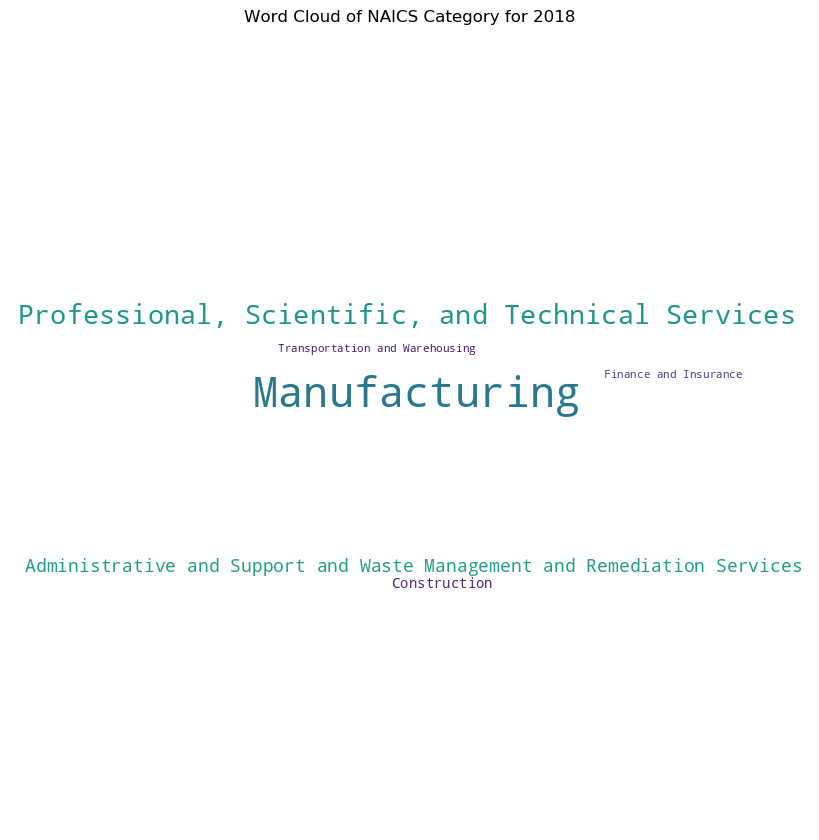

{'Agriculture, Forestry, Fishing and Hunting': 0.0872842516115254, 'Mining, Quarrying, and Oil and Gas Extraction': 0.0386867415821151, 'Utilities': 0.4164645931315213, 'Construction': 6.849719806808658, 'Manufacturing': 41.66827250408247, 'Wholesale Trade': 1.4642417716497664, 'Retail Trade': 0.2176255840295148, 'Transportation and Warehousing': 3.081428142794847, 'Information': 2.2792289781649746, 'Finance and Insurance': 2.2665931577372453, 'Real Estate and Rental and Leasing': 0.1893530572757615, 'Professional, Scientific, and Technical Services': 30.0573927974762, 'Administrative and Support and Waste Management and Remediation Services': 7.504041043367255, 'Educational Services': 0.8678055332733751, 'Health Care and Social Assistance': 2.080205539991991, 'Arts, Entertainment, and Recreation': 0.0392537035359182, 'Accommodation and Food Services': 0.1887304967044639, 'Other Services (except Public Administration)': 0.5577455383166554, 'Public Administration (not covered in economi

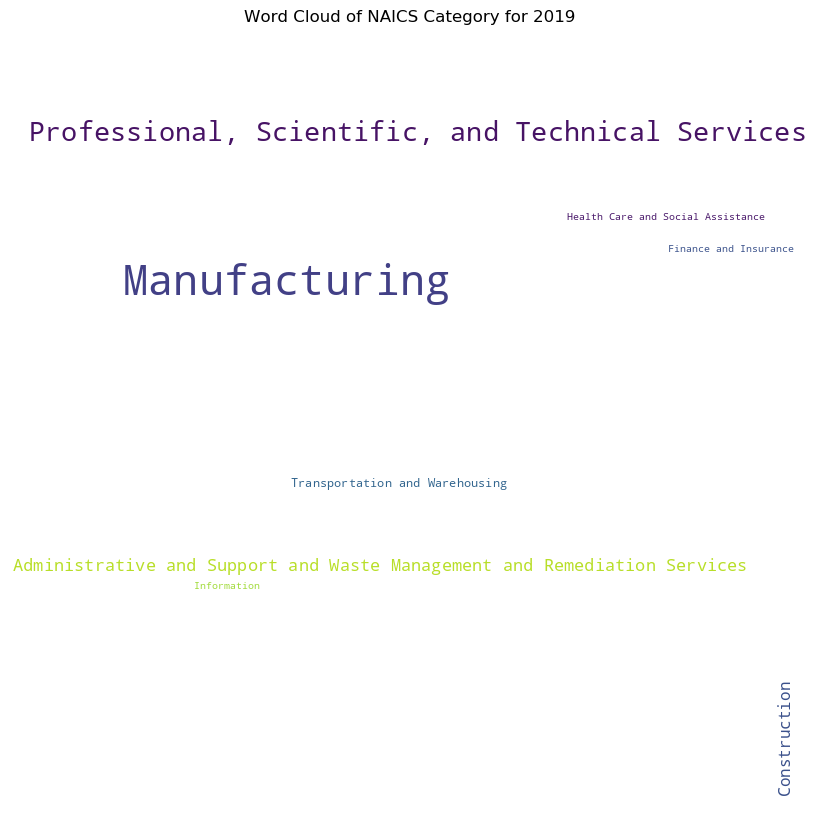

{'Agriculture, Forestry, Fishing and Hunting': 0.1559258257797846, 'Mining, Quarrying, and Oil and Gas Extraction': 0.0383175302150201, 'Utilities': 0.3135522025712081, 'Construction': 6.868479592298677, 'Manufacturing': 38.66187262525968, 'Wholesale Trade': 2.18425844097859, 'Retail Trade': 0.1799041653796156, 'Transportation and Warehousing': 3.077594610675964, 'Information': 2.3505900420095824, 'Finance and Insurance': 3.4039082334575808, 'Real Estate and Rental and Leasing': 0.1525576764871216, 'Professional, Scientific, and Technical Services': 29.750985799551472, 'Administrative and Support and Waste Management and Remediation Services': 8.378936123468495, 'Educational Services': 0.7327137876720111, 'Health Care and Social Assistance': 2.7942286936139467, 'Arts, Entertainment, and Recreation': 0.0296329014320852, 'Accommodation and Food Services': 0.2358605952158259, 'Other Services (except Public Administration)': 0.598174125634741, 'Public Administration (not covered in economi

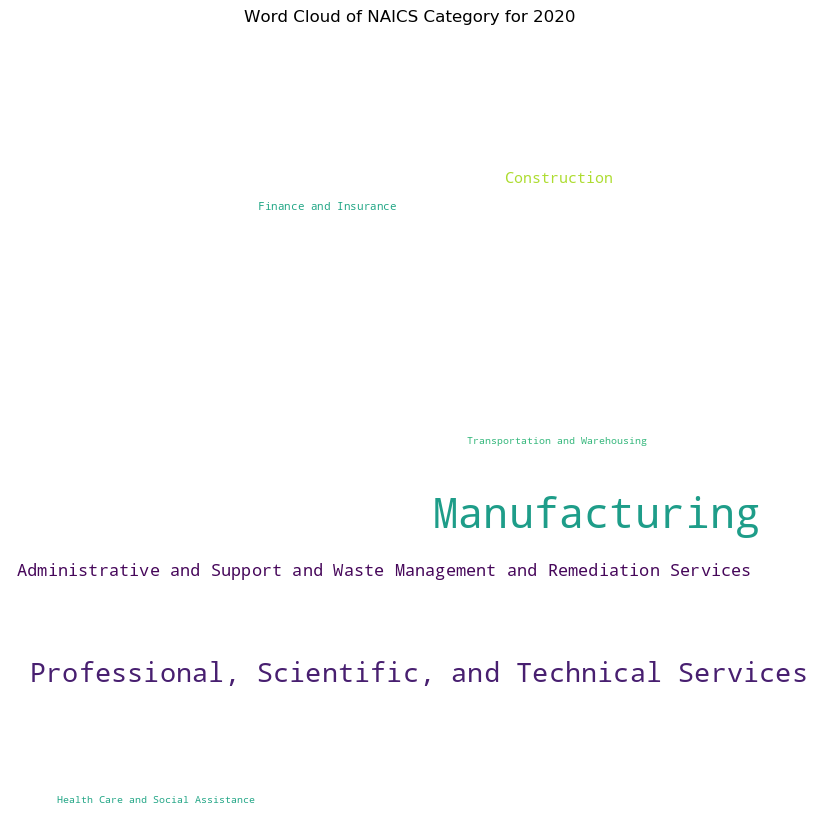

In [84]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# read the csv file
df = pd.read_csv('us_funding_time_series.csv')

# loop through the years
for year in range(2016, 2021):
    # create a dictionary that contains the NAICS category as the key and the funding percentage for the current year as the value
    category_weight = {}
    for index, row in df.iterrows():
        category = row['NAICS Category']
        weight = row[str(year)]
        category_weight[category] = weight
    print(category_weight)

    # create a word cloud object and generate the word cloud using the dictionary
    wordcloud = WordCloud(width = 800, height = 800, 
                    background_color ='white', 
                    min_font_size = 10,
                    max_words = 50, # limit the number of words
                   ).generate_from_frequencies(category_weight)

    # plot the word cloud using matplotlib
    plt.figure(figsize = (8, 8), facecolor = None) 
    plt.imshow(wordcloud, aspect='equal') # use equal aspect ratio to prevent stretching
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(f"Word Cloud of NAICS Category for {year}") # add a title
    plt.show()


['"Manufacturing"', '"Professional, Scientific, and Technical Services"', '"Administrative and Support and Waste Management and Remediation Services"', '"Construction"', '"Finance and Insurance"']


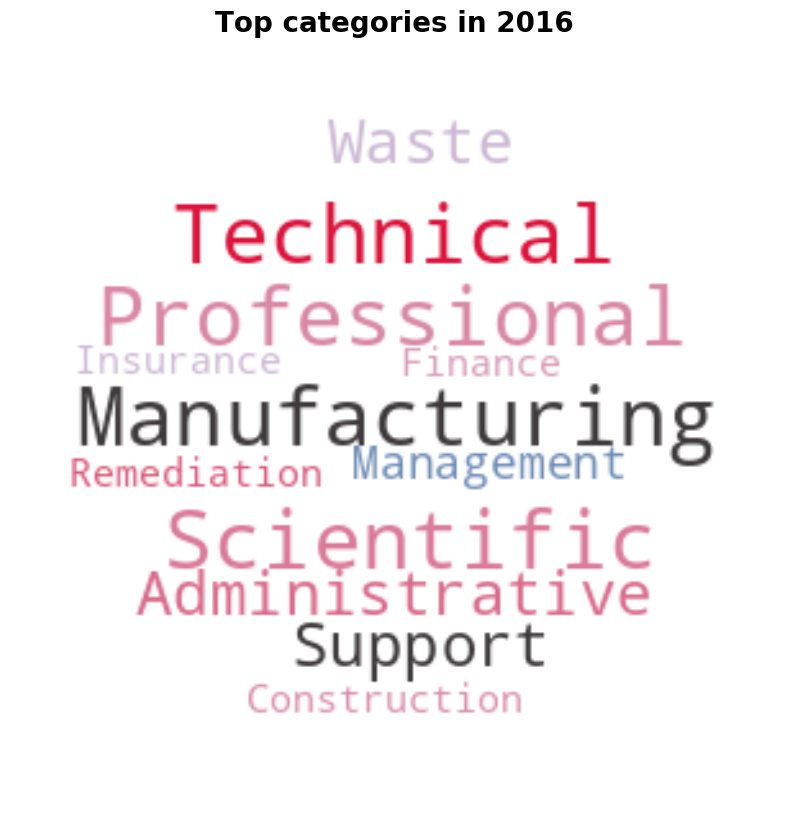

['"Manufacturing"', '"Professional, Scientific, and Technical Services"', '"Administrative and Support and Waste Management and Remediation Services"', '"Construction"', '"Transportation and Warehousing"']


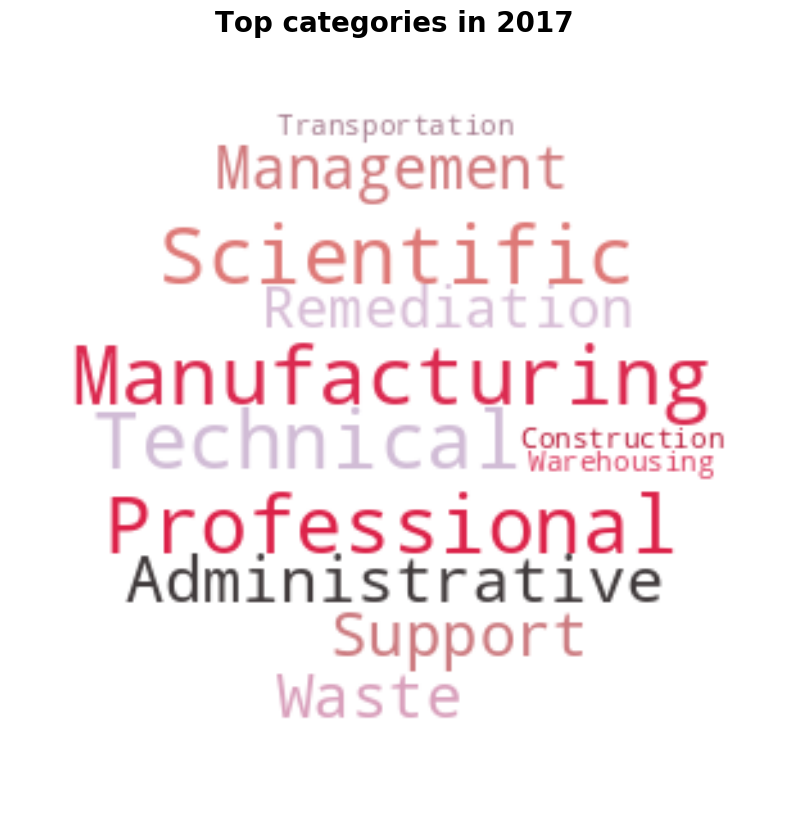

['"Manufacturing"', '"Professional, Scientific, and Technical Services"', '"Administrative and Support and Waste Management and Remediation Services"', '"Construction"', '"Finance and Insurance"']


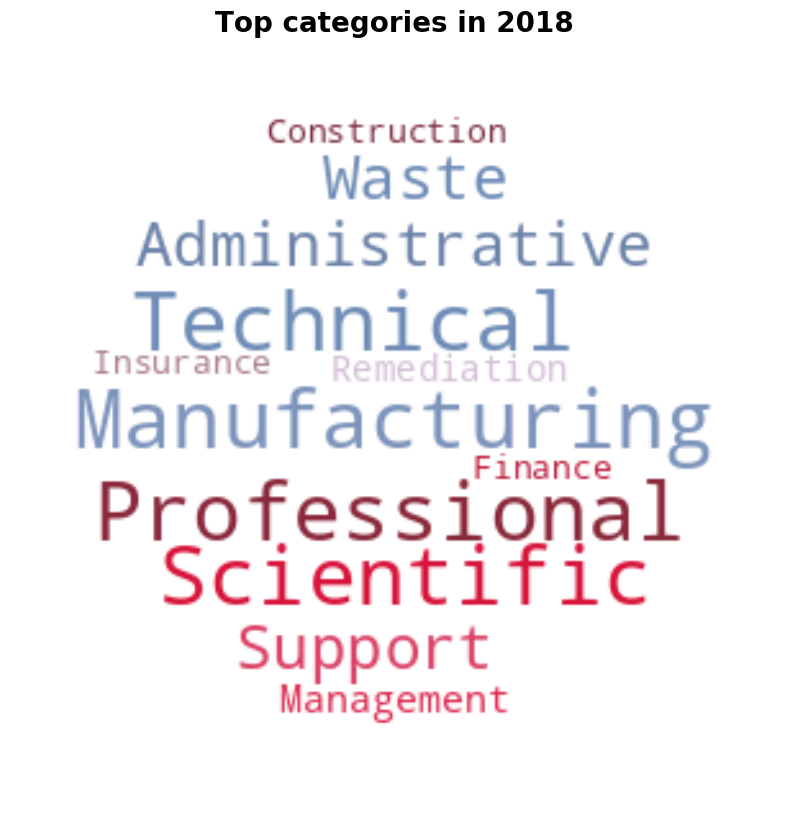

['"Manufacturing"', '"Professional, Scientific, and Technical Services"', '"Administrative and Support and Waste Management and Remediation Services"', '"Construction"', '"Transportation and Warehousing"']


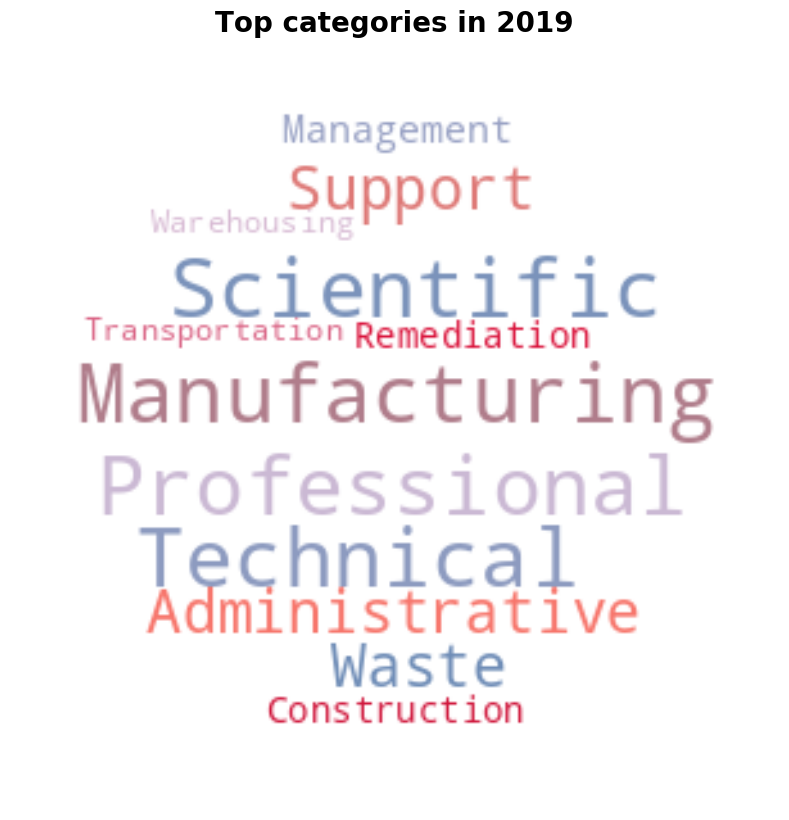

['"Manufacturing"', '"Professional, Scientific, and Technical Services"', '"Administrative and Support and Waste Management and Remediation Services"', '"Construction"', '"Finance and Insurance"']


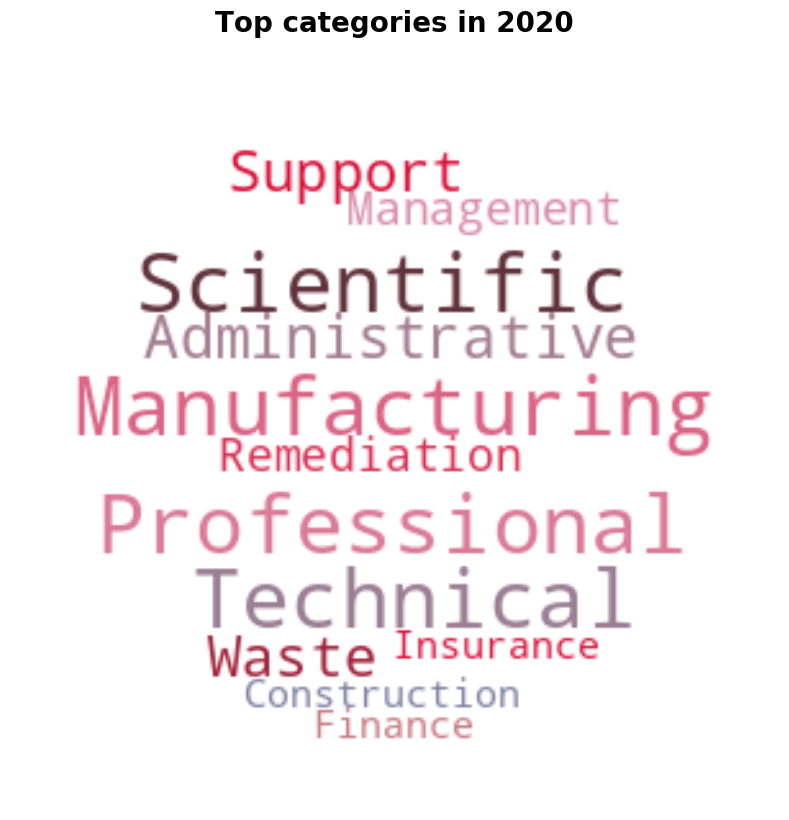

In [71]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors

# load the data
df = pd.read_csv('us_funding_time_series.csv')

# define a custom color map
meranti_colors = ['#FC766AFF', '#5B84B1FF', '#D8BFD8FF', '#DC143CFF', '#3C3C3CFF']
meranti_colors_rgb = [mcolors.hex2color(color) for color in meranti_colors]
meranti_cmap = mcolors.LinearSegmentedColormap.from_list('meranti', meranti_colors_rgb)

# define a custom word cloud shape
x, y = np.ogrid[:300, :300]
mask = (x - 150) ** 2 + (y - 150) ** 2 > 130 ** 2
mask = 255 * mask.astype(int)

# iterate over the years and get the top 10 categories for each year
for year in range(2016, 2021):
    # select rows where funding for the given year is not null
    not_null_rows = df.loc[df[f"{year}"].notnull()]

    # sort the not-null rows by funding percentage in descending order and select the top 5 categories
    top_5_categories = not_null_rows.sort_values(by=f"{year}", ascending=False).head(5)

    # extract the category names as a list, filter out any category containing "service", and join them with double quotes to ensure they stay as a whole
    category_list = [f'"{name}"' for name in top_5_categories["NAICS Category"].tolist()]
    print(category_list)

    # combine the category names into a single string
    text = ' '.join(category_list)
    text = text.replace("Services", " ")

    # create a word cloud object with custom color map and mask
    wordcloud = WordCloud(background_color="white", colormap=meranti_cmap, mask=mask).generate(text)

    # plot the word cloud
    plt.figure(figsize=(8, 8))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Top categories in {year}", fontsize=20, fontweight='bold')
    plt.tight_layout(pad=0)
    plt.show()


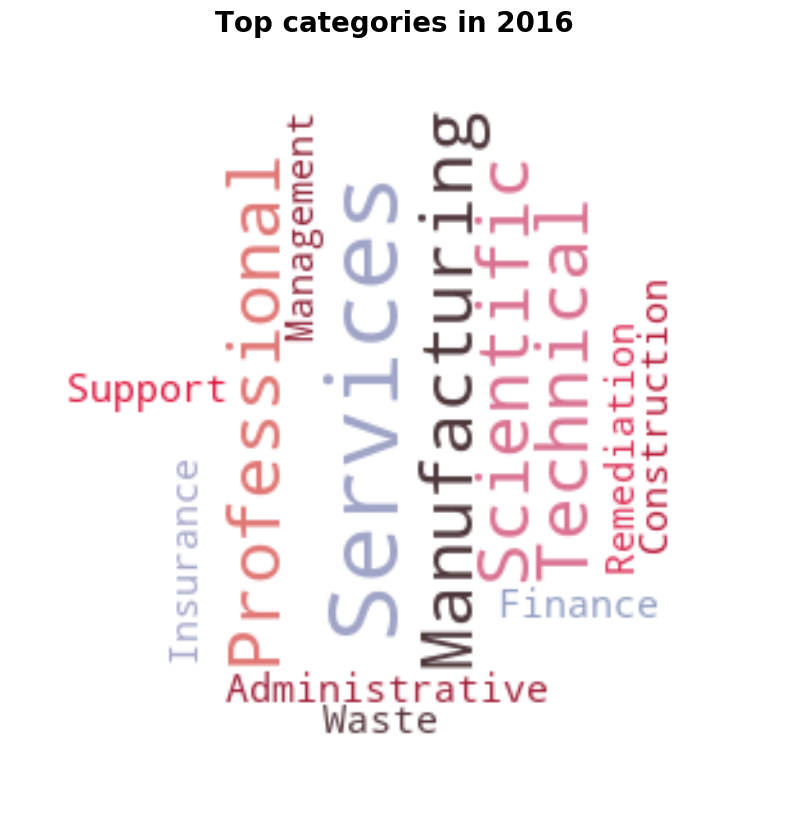

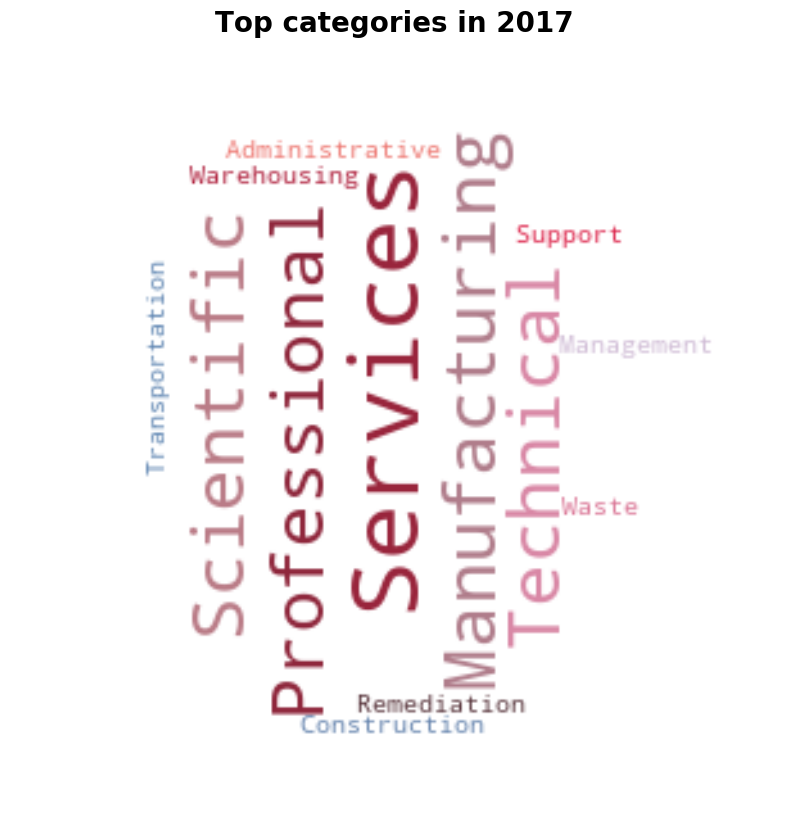

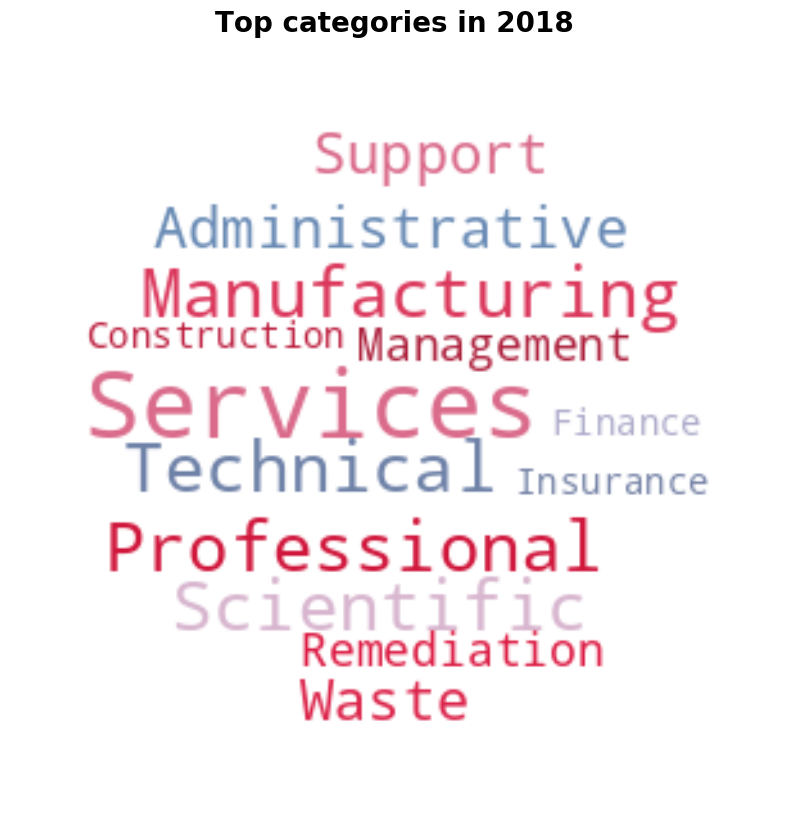

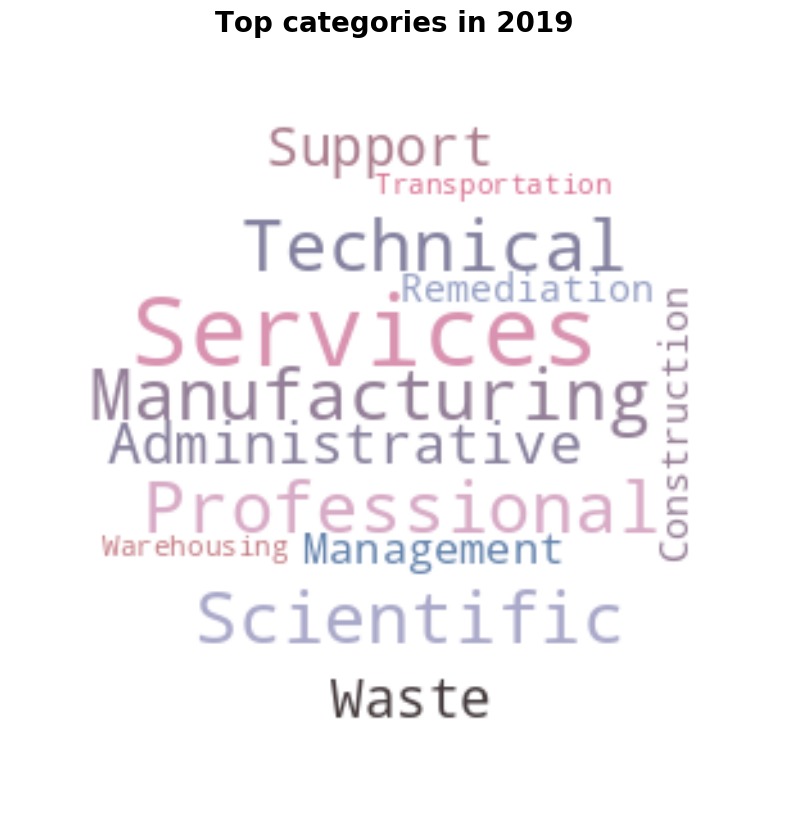

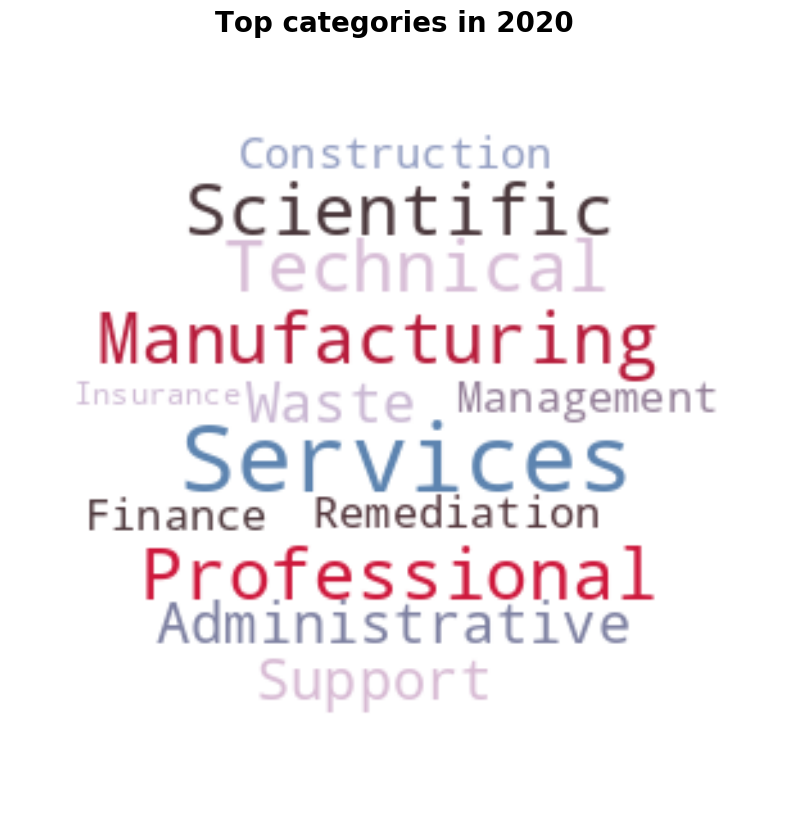

In [66]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors

# load the data
df = pd.read_csv('us_funding_time_series.csv')

# define a custom color map
meranti_colors = ['#FC766AFF', '#5B84B1FF', '#D8BFD8FF', '#DC143CFF', '#3C3C3CFF']
meranti_colors_rgb = [mcolors.hex2color(color) for color in meranti_colors]
meranti_cmap = mcolors.LinearSegmentedColormap.from_list('meranti', meranti_colors_rgb)

# define a custom word cloud shape
x, y = np.ogrid[:300, :300]
mask = (x - 150) ** 2 + (y - 150) ** 2 > 130 ** 2
mask = 255 * mask.astype(int)

# iterate over the years and get the top 10 categories for each year
for year in range(2016, 2021):
    # select rows where funding for the given year is not null
    not_null_rows = df.loc[df[f"{year}"].notnull()]

    # sort the not-null rows by funding percentage in descending order and select the top 5 categories
    top_5_categories = not_null_rows.sort_values(by=f"{year}", ascending=False).head(5)

    # extract the category names as a list, replace the word "service" with an empty string, and join them with double quotes to ensure they stay as a whole
    category_list = [f'"{name.replace("service", "")}"' for name in top_5_categories["NAICS Category"].tolist()]

    # combine the category names into a single string
    text = ' '.join(category_list)

    # create a word cloud object with custom color map and mask
    wordcloud = WordCloud(background_color="white", colormap=meranti_cmap, mask=mask).generate(text)

    # plot the word cloud
    plt.figure(figsize=(8, 8))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Top categories in {year}", fontsize=20, fontweight='bold')
    plt.tight_layout(pad=0)
    plt.show()


In [50]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Read CSV file
df = pd.read_csv('us_funding_time_series.csv', index_col=0)

# iterate over the years and get the top 10 categories for each year
for year in range(2016, 2021):
    # sort the data for the given year by funding percentage and get the top 10 categories
    top_categories = df.loc[df[f"{year}"].notnull()].sort_values(by=f"{year}", ascending=False).head(10)["NAICS Category"].tolist()

    # combine the category names into a single string
    text = ' '.join(top_categories)

    # generate the word cloud for the year
    wordcloud = WordCloud(background_color="white").generate(text)

    # add a trace for the year to the Plotly figure
    trace = go.Scatter(
        x=df.index,
        y=df[f"{year}"],
        mode='lines',
        stackgroup='one',
        name=year
    )
    fig.add_trace(trace, row=1, col=1)

    # add a click event handler to the trace to show the word cloud when clicked
    fig.data[-1].on_click(lambda trace, points, state: show_wordcloud(wordcloud))

# Create stacked area chart using Plotly
fig = make_subplots(rows=1, cols=1, shared_xaxes=True, vertical_spacing=1)

# Set layout and axis labels
fig.update_layout(
    title='Funding by NAICS Category Over Time',
    xaxis_title='Category',
    yaxis_title='Percentage',
    hovermode='x unified',
    legend_title='Year',
    height=600,
    width=1200,
    yaxis_type='log'
)

# function to show the word cloud
def show_wordcloud(wordcloud):
    plt.figure()
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show chart
fig.show()


KeyError: 'NAICS Category'

In [73]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Read CSV file
df = pd.read_csv('us_funding_time_series.csv', index_col=0)

# Create stacked area chart using Plotly
fig = make_subplots(rows=1, cols=1, shared_xaxes=True, vertical_spacing=1)
for i, col in enumerate(df.columns):
    fig.add_trace(go.Scatter(
        x=df.index,
        y=df[col],
        mode='lines+markers',
        stackgroup='one',
        name=col
    ), row=1, col=1)

# Set layout and axis labels
fig.update_layout(
    title='Funding by NAICS Category Over Time',
    xaxis_title='Category',
    yaxis_title='Percentage',
    hovermode='x unified',
    legend_title='Year',
    height=600,
    width=1200,
    yaxis_type='log'
)

# Define a function to create wordcloud for the top 10 categories of a given year
def create_wordcloud(year):
    top_categories = df.loc[:, year].nlargest(10).index.tolist()
    wordcloud_text = ' '.join(top_categories)
    wordcloud = WordCloud(width=800, height=400).generate(wordcloud_text)
    plt.figure(figsize=(20, 10))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.show()

# Define a callback function to generate wordcloud on click of the year in the legend
def update_legend(trace, points, state):
    year = trace.name
    create_wordcloud(year)

# Add callback to the legend
for trace in fig.data:
    trace.on_click(update_legend)

# Show chart
fig.show()


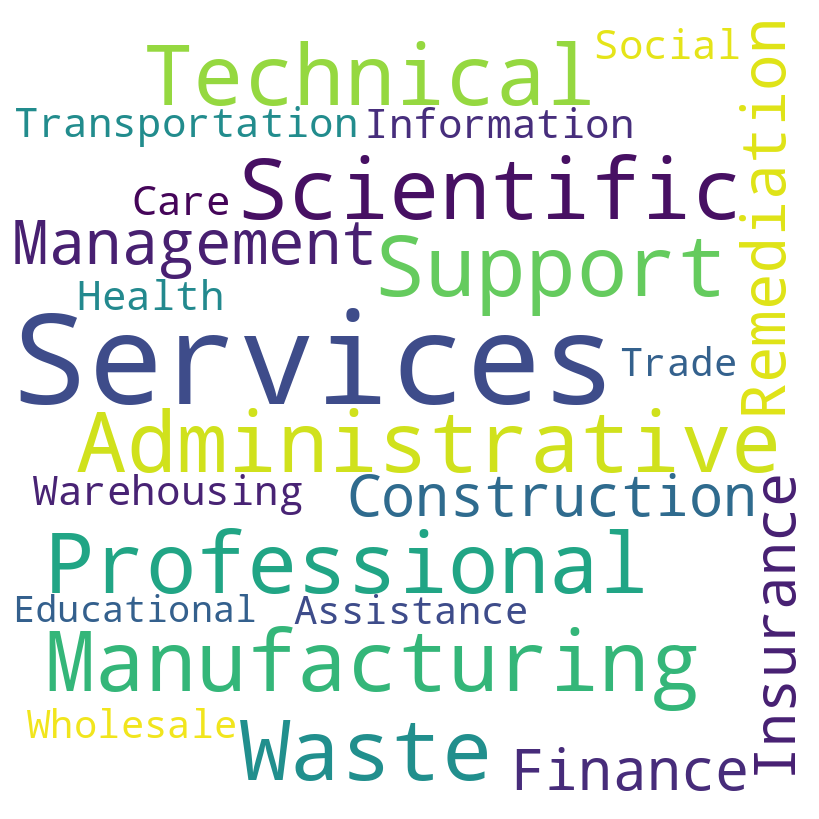

In [84]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Read CSV file
df = pd.read_csv('us_funding_time_series.csv', index_col=0)

# Create stacked area chart using Plotly
fig = make_subplots(rows=1, cols=1, shared_xaxes=True, vertical_spacing=1)
for i, col in enumerate(df.columns):
    fig.add_trace(go.Scatter(
        x=df.index,
        y=df[col],
        mode='lines+markers',
        stackgroup='one',
        name=col
    ), row=1, col=1)

# Set layout and axis labels
fig.update_layout(
    title='Funding by NAICS Category Over Time',
    xaxis_title='Category',
    yaxis_title='Percentage',
    hovermode='x unified',
    legend_title='Year',
    height=600,
    width=1200,
    yaxis_type='log'
)

# Define function to generate word cloud for a given year
def generate_wordcloud(year):
    categories = df.loc[:, year].sort_values(ascending=False)[:10]
    text = ' '.join([f'{cat}: {round(val*100, 2)}%' for cat, val in categories.items()])
    wordcloud = WordCloud(width=800, height=800, background_color='white').generate(text)
    plt.figure(figsize=(8, 8), facecolor=None)
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.tight_layout(pad=0)
    plt.show()

# Define function to update the word cloud based on the selected year
def update_wordcloud(trace, points, selector):
    year = points.point_inds[0] + 2016
    generate_wordcloud(year)

# Add button to generate word cloud for the top 10 categories of each year
buttons = []
for year in range(2016, 2021):
    button = dict(label=str(year),
                  method='update',
                  args=[{'visible': [False] * (len(df.columns) - 1) + [True]},
                        {'title': f'Top 10 categories in {year}',
                         'annotations': [],
                         'yaxis': {'title': 'Percentage'},
                         'shapes': [{'type': 'rect',
                                     'xref': 'paper',
                                     'yref': 'paper',
                                     'x0': 0,
                                     'y0': 0,
                                     'x1': 1,
                                     'y1': 1,
                                     'fillcolor': 'rgba(0,0,0,0)',
                                     'line': {'width': 1.5}}]}])
    button['args'][0]['visible'][year-2016] = True
    button['args'].append({'annotations': [{'text': f'Top 10 categories in {year}',
                                             'x': 0.5,
                                             'y': 1.1,
                                             'showarrow': False,
                                             'font': {'size': 20}}]})
    buttons.append(button)

# Add button to reset to original view
buttons.append(dict(label='Reset',
                    method='update',
                    args=[{'visible': [True] * len(df.columns)},
                          {'title': 'Funding by NAICS Category Over Time',
                           'annotations': [],
                           'yaxis': {'title': 'Percentage'},
                           'shapes': [{'type': 'rect',
                                       'xref': 'paper',
                                       'yref': 'paper',
                                       'xref': 0,
'y0': 0,
'x1': 1,
'y1': 1,
'fillcolor': 'rgba(0,0,0,0)',
'line': {'width': 1.5}}]}]))

# Add buttons to the layout
fig.update_layout(
    updatemenus=[dict(
    type='buttons',
    showactive=False,
    buttons=buttons,
    direction='right',
    x=0.1,
    y=1.15,
    font=dict(size=14)
    )]
)

# Add a word cloud for the initial year
generate_wordcloud("2018")

# Add click event to the stacked area chart to update the word cloud
fig.data[0].on_click(update_wordcloud)

# Show the figure
fig.show()


In [89]:
import pandas as pd
import plotly.express as px

# Load the data into a pandas dataframe
df = pd.read_csv('us_expenditure_time_series.csv')

# Reshape the data into a long format for use in Plotly
df_long = pd.melt(df, id_vars=['Category'], var_name='Year', value_name='Expenditure')

# Create a line chart of the expenditures in each category over time using Plotly
fig = px.line(df_long, x='Year', y='Expenditure', title='Expenditures by Category over Time', color='Category')
fig.show()


In [90]:
# Calculate the total expenditure for each year
df['Total'] = df.sum(axis=1)

# Calculate the percentage of total expenditure accounted for by each category for each year
for col in df.columns[1:]:
    df[col + '_Percentage'] = df[col] / df['Total'] * 100

# Reshape the data into a long format for use in Plotly
df_long = pd.melt(df, id_vars=['Category'], var_name='Year', value_name='Percentage')

# Create a stacked area chart to show the percentage of total expenditures accounted for by each category over time using Plotly
fig = px.area(df_long, x='Year', y='Percentage', title='Percentage of Total Expenditure by Category over Time', color='Category')
fig.show()


/tmp/user/21864/ipykernel_3185028/569070877.py:2: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



In [92]:
# Create a treemap to show the distribution of expenditures by category for the year 2020 using Plotly
fig = px.treemap(df, path=['Category'], values='2019', title='Distribution of Expenditures by Category (2020)')
fig.show()


In [93]:
import plotly.graph_objects as go
import pandas as pd

# Load the datasets
funding_data = pd.read_csv('us_funding_time_series.csv')
expenditure_data = pd.read_csv('us_expenditure_time_series.csv')

# Set the x-axis categories
categories = funding_data['NAICS Category']

# Create the traces for the funding and expenditure data for each year
funding_traces = []
expenditure_traces = []

for year in funding_data.columns[1:]:
    funding_trace = go.Bar(
        x=categories,
        y=funding_data[year],
        name=f'{year} Funding'
    )
    funding_traces.append(funding_trace)
    
    expenditure_trace = go.Bar(
        x=categories,
        y=expenditure_data[year],
        name=f'{year} Expenditure'
    )
    expenditure_traces.append(expenditure_trace)

# Create the stacked bar chart
fig = go.Figure(
    data=funding_traces + expenditure_traces,
    layout=go.Layout(
        barmode='stack',
        title='US Funding vs. Expenditure by Industry Category',
        xaxis=dict(title='Industry Category'),
        yaxis=dict(title='Percentage')
    )
)

fig.show()


In [95]:
import plotly.graph_objs as go
import pandas as pd

# Load data
expenditure_df = pd.read_csv("2019_cleaned_expenditure.csv")
poverty_df = pd.read_csv("us_cleaned_poverty.csv")

# Merge data
merged_df = pd.merge(expenditure_df, poverty_df, on="State")

# Create scatter plot
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=merged_df["State Expenditure (in thousands)"],
    y=merged_df["3-Year Average Poverty Rate (2018-2020)"],
    mode="markers",
    marker=dict(size=10, color="blue"),
    text=merged_df["State"]
))

# Update layout
fig.update_layout(
    title="State Expenditure vs Poverty Rate (2018-2020)",
    xaxis_title="State Expenditure (in thousands)",
    yaxis_title="3-Year Average Poverty Rate",
    font=dict(family="Arial", size=12),
    hovermode="closest"
)

# Show plot
fig.show()


In [96]:
import plotly.express as px
import pandas as pd

# Load data
expenditure_df = pd.read_csv("2019_cleaned_expenditure.csv")
poverty_df = pd.read_csv("us_cleaned_poverty.csv")

# Merge data
merged_df = pd.merge(expenditure_df, poverty_df, on="State")

# Create scatter plot with regression line
fig = px.scatter(merged_df, x="State Expenditure (in thousands)", y="3-Year Average Poverty Rate (2018-2020)",
                 trendline="ols", trendline_color_override="red", labels={"State Expenditure (in thousands)": "Expenditure", "3-Year Average Poverty Rate (2018-2020)": "Poverty Rate"})

# Update layout
fig.update_layout(
    title="State Expenditure vs Poverty Rate (2018-2020)",
    font=dict(family="Arial", size=12),
    hovermode="closest"
)

# Show plot
fig.show()


ModuleNotFoundError: No module named 'statsmodels'

In [1]:
import pandas as pd
import plotly.express as px

# Read in the data
df = pd.read_csv('us_funding_time_series.csv')

# Calculate the total funding for each category
df['Total Funding'] = df.sum(axis=1)

# Sort the categories based on their total funding
df_sorted = df.sort_values('Total Funding', ascending=False)

# Select the top 10 categories
top_10_categories = df_sorted['NAICS Category'].head(10)

# Filter the data to only include the top 10 categories
df_top_10 = df[df['NAICS Category'].isin(top_10_categories)]

# Melt the data so that each row represents a single observation
df_melt = pd.melt(df_top_10, id_vars=['NAICS Category'], var_name='Year', value_name='Funding')

# Create the stacked bar chart using Plotly Express
fig = px.bar(df_melt, x='Year', y='Funding', color='NAICS Category', barmode='stack')

# Update the x-axis to show only the years
fig.update_xaxes(type='category')

# Show the chart
fig.show()


/tmp/user/21864/ipykernel_1499414/2271149834.py:8: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df['Total Funding'] = df.sum(axis=1)


In [4]:
import pandas as pd
import plotly.express as px

# Read in the data
df = pd.read_csv('us_funding_time_series.csv')

# Melt the data so that each row represents a single observation
df_melt = pd.melt(df, id_vars=['NAICS Category'], var_name='Year', value_name='Percentage')

# Create the stacked bar chart using Plotly Express
fig = px.bar(df_melt, x='Year', y='Percentage', color='NAICS Category', barmode='stack')

# Update the x-axis to show only the years
fig.update_xaxes(type='category')

# Show the chart
fig.show()


In [6]:
import plotly.graph_objs as go
import pandas as pd

# Load data
df16 = pd.read_csv("2016_per_capita_analysis.csv")
df17 = pd.read_csv("2017_per_capita_analysis.csv")
populations = pd.read_csv("us_cleaned_population.csv")

# Merge dataframes
df = pd.merge(df16, df17, on="State", suffixes=("_2016", "_2017"))
df = pd.merge(df, populations, on="State")

# Create scatter plot
fig = go.Figure(data=go.Scatter(
    x=df["Population"],
    y=df["Expenditure per Capita (in thousands)_2016"],
    mode="markers",
    marker=dict(
        size=10,
        color=df["Expenditure per Capita (in thousands)_2017"],
        colorscale="Viridis",
        colorbar=dict(title="Expenditure per Capita (in thousands)_2017")
    ),
    text=df["State"]
))

# Customize layout
fig.update_layout(
    title="Expenditure per Capita vs Population",
    xaxis_title="Population",
    yaxis_title="Expenditure per Capita (in thousands)_2016"
)

# Show plot
fig.show()


In [7]:
import plotly.graph_objs as go
import pandas as pd

# Load data
df16 = pd.read_csv("2016_per_capita_analysis.csv")
df17 = pd.read_csv("2017_per_capita_analysis.csv")
populations = pd.read_csv("us_cleaned_population.csv")

# Merge dataframes
df = pd.merge(df16, df17, on="State", suffixes=("_2016", "_2017"))
df = pd.merge(df, populations, on="State")

# Calculate mean Expenditure per Capita
mean_expenditure = df["Expenditure per Capita (in thousands)_2016"].mean()

# Create scatter plot
fig = go.Figure()

# Add scatter trace
fig.add_trace(go.Scatter(
    x=df["Population"],
    y=df["Expenditure per Capita (in thousands)_2016"],
    mode="markers",
    marker=dict(
        size=10,
        color=df["Expenditure per Capita (in thousands)_2017"],
        colorscale="Viridis",
        colorbar=dict(title="Expenditure per Capita (in thousands)_2017")
    ),
    text=df["State"]
))

# Add mean line
fig.add_shape(
    type="line",
    x0=df["Population"].min(),
    x1=df["Population"].max(),
    y0=mean_expenditure,
    y1=mean_expenditure,
    line=dict(color="red", width=2)
)

# Customize layout
fig.update_layout(
    title="Expenditure per Capita vs Population",
    xaxis_title="Population",
    yaxis_title="Expenditure per Capita (in thousands)_2016"
)

# Show plot
fig.show()


In [8]:
import plotly.graph_objs as go
import pandas as pd

# Load data
df16 = pd.read_csv("2016_per_capita_analysis.csv").drop(0)
df17 = pd.read_csv("2017_per_capita_analysis.csv").drop(0)
populations = pd.read_csv("us_cleaned_population.csv").drop(0)

# Merge dataframes
df = pd.merge(df16, df17, on="State", suffixes=("_2016", "_2017"))
df = pd.merge(df, populations, on="State")

# Calculate mean Expenditure per Capita
mean_expenditure = df["Expenditure per Capita (in thousands)_2016"].mean()

# Create scatter plot
fig = go.Figure()

# Add scatter trace
fig.add_trace(go.Scatter(
    x=df["Population"],
    y=df["Expenditure per Capita (in thousands)_2016"],
    mode="markers",
    marker=dict(
        size=10,
        color=df["Expenditure per Capita (in thousands)_2017"],
        colorscale="Viridis",
        colorbar=dict(title="Expenditure per Capita (in thousands)_2017")
    ),
    text=df["State"]
))

# Add mean line
fig.add_shape(
    type="line",
    x0=df["Population"].min(),
    x1=df["Population"].max(),
    y0=mean_expenditure,
    y1=mean_expenditure,
    line=dict(color="red", width=2)
)

# Customize layout
fig.update_layout(
    title="Expenditure per Capita vs Population",
    xaxis_title="Population",
    yaxis_title="Expenditure per Capita (in thousands)_2016"
)

# Show plot
fig.show()


In [21]:
import plotly.graph_objs as go
import pandas as pd

# Load data
# df16 = pd.read_csv("2016_per_capita_analysis.csv")
# df17 = pd.read_csv("2017_per_capita_analysis.csv")
# df18 = pd.read_csv("2018_per_capita_analysis.csv")
# Merge dataframes
# df = pd.merge(df16, df17, on="State")

df1 = pd.read_csv("2016_per_capita_analysis.csv")
df2 = pd.read_csv("2017_per_capita_analysis.csv")
df3 = pd.read_csv("2018_per_capita_analysis.csv")
df4 = pd.read_csv("2019_per_capita_analysis.csv")
df5 = pd.read_csv("2020_per_capita_analysis.csv")

frames = [df1, df2, df3, df4, df5]
merged_df = pd.concat(frames, axis=0, ignore_index=True)

merged_df


,State,Expenditure per Capita (in thousands),Funding received per Capita (in thousands)
0,Alabama,9.411330,2.325560
1,Alaska,21.597592,5.357142
2,Arizona,7.844778,1.798789
3,Arkansas,8.893309,0.163366
4,California,13.911994,1.525690
...,...,...,...
250,Virginia,11.341198,12.575552
251,Washington,14.572282,1.472666
252,West Virginia,11.326578,0.303641
253,Wisconsin,11.467174,1.152921


In [16]:
import plotly.graph_objs as go
import pandas as pd

# Load data
df = pd.read_csv("2016_per_capita_analysis.csv")
df = df.drop(df[df["State"] == "United States"].index)
populations = pd.read_csv("us_cleaned_population.csv")
populations = populations.drop(populations[populations["State"] == "United States"].index)

# Merge dataframes
df = pd.merge(df, populations, on="State")

# Calculate mean Expenditure per Capita
mean_expenditure = df["Expenditure per Capita (in thousands)"].mean()

# Create scatter plot
fig = go.Figure()

# Add scatter trace
fig.add_trace(go.Scatter(
    x=df["Population"],
    y=df["Expenditure per Capita (in thousands)"],
    mode="markers",
    marker=dict(
        size=10,
        color=df["Expenditure per Capita (in thousands)"],
        colorscale="Viridis",
        colorbar=dict(title="Expenditure per Capita (in thousands)")
    ),
    text=df["State"]
))

# Add mean line
fig.add_shape(
    type="line",
    x0=df["Population"].min(),
    x1=df["Population"].max(),
    y0=mean_expenditure,
    y1=mean_expenditure,
    line=dict(color="red", width=2)
)

# Customize layout
fig.update_layout(
    title="Expenditure per Capita vs Population",
    xaxis_title="Population",
    yaxis_title="Expenditure per Capita (in thousands)"
)

# Show plot
fig.show()


In [11]:
import plotly.graph_objs as go
import pandas as pd

# Load data
df = pd.read_csv("2017_per_capita_analysis.csv").drop(0)
populations = pd.read_csv("us_cleaned_population.csv").drop(0)

# Merge dataframes
df = pd.merge(df, populations, on="State")

# Calculate mean Expenditure per Capita
mean_expenditure = df["Expenditure per Capita (in thousands)"].mean()

# Create scatter plot
fig = go.Figure()

# Add scatter trace
fig.add_trace(go.Scatter(
    x=df["Population"],
    y=df["Expenditure per Capita (in thousands)"],
    mode="markers",
    marker=dict(
        size=10,
        color=df["Expenditure per Capita (in thousands)"],
        colorscale="Viridis",
        colorbar=dict(title="Expenditure per Capita (in thousands)")
    ),
    text=df["State"]
))

# Add mean line
fig.add_shape(
    type="line",
    x0=df["Population"].min(),
    x1=df["Population"].max(),
    y0=mean_expenditure,
    y1=mean_expenditure,
    line=dict(color="red", width=2)
)

# Customize layout
fig.update_layout(
    title="Expenditure per Capita vs Population",
    xaxis_title="Population",
    yaxis_title="Expenditure per Capita (in thousands)"
)

# Show plot
fig.show()


In [12]:
import plotly.graph_objs as go
import pandas as pd

# Load data
df = pd.read_csv("2018_per_capita_analysis.csv").drop(0)
populations = pd.read_csv("us_cleaned_population.csv").drop(0)

# Merge dataframes
df = pd.merge(df, populations, on="State")

# Calculate mean Expenditure per Capita
mean_expenditure = df["Expenditure per Capita (in thousands)"].mean()

# Create scatter plot
fig = go.Figure()

# Add scatter trace
fig.add_trace(go.Scatter(
    x=df["Population"],
    y=df["Expenditure per Capita (in thousands)"],
    mode="markers",
    marker=dict(
        size=10,
        color=df["Expenditure per Capita (in thousands)"],
        colorscale="Viridis",
        colorbar=dict(title="Expenditure per Capita (in thousands)")
    ),
    text=df["State"]
))

# Add mean line
fig.add_shape(
    type="line",
    x0=df["Population"].min(),
    x1=df["Population"].max(),
    y0=mean_expenditure,
    y1=mean_expenditure,
    line=dict(color="red", width=2)
)

# Customize layout
fig.update_layout(
    title="Expenditure per Capita vs Population",
    xaxis_title="Population",
    yaxis_title="Expenditure per Capita (in thousands)"
)

# Show plot
fig.show()


In [14]:
import plotly.graph_objs as go
import pandas as pd

# Load data
df16 = pd.read_csv("2016_per_capita_analysis.csv")
df17 = pd.read_csv("2017_per_capita_analysis.csv")

# Select state
state = "California"

# Filter data for selected state
df16 = df16[df16["State"] == state]
df17 = df17[df17["State"] == state]

# Create line chart
fig = go.Figure()

# Add traces
fig.add_trace(go.Scatter(
    x=df16["Category"],
    y=df16["Expenditure per Capita (in thousands)"],
    name="2016",
    mode="lines",
    line=dict(color="blue")
))

fig.add_trace(go.Scatter(
    x=df17["Category"],
    y=df17["Expenditure per Capita (in thousands)"],
    name="2017",
    mode="lines",
    line=dict(color="red")
))

# Customize layout
fig.update_layout(
    title=f"Expenditure per Capita by Category in {state}",
    xaxis_title="Category",
    yaxis_title="Expenditure per Capita (in thousands)"
)

# Show plot
fig.show()


KeyError: 'Category'

In [22]:
import plotly.graph_objs as go
import pandas as pd

def create_scatterplot(year):
    # Load data
    df = pd.read_csv(f"{year}_per_capita_analysis.csv").drop(0)
    populations = pd.read_csv("us_cleaned_population.csv").drop(0)

    # Merge dataframes
    df = pd.merge(df, populations, on="State")

    # Calculate mean Expenditure per Capita
    mean_expenditure = df["Expenditure per Capita (in thousands)"].mean()

    # Create scatter plot
    fig = go.Figure()

    # Add scatter trace
    fig.add_trace(go.Scatter(
        x=df["Population"],
        y=df["Expenditure per Capita (in thousands)"],
        mode="markers",
        marker=dict(
            size=10,
            color=df["Expenditure per Capita (in thousands)"],
            colorscale="Viridis",
            colorbar=dict(title="Expenditure per Capita (in thousands)")
        ),
        text=df["State"]
    ))

    # Add mean line
    fig.add_shape(
        type="line",
        x0=df["Population"].min(),
        x1=df["Population"].max(),
        y0=mean_expenditure,
        y1=mean_expenditure,
        line=dict(color="red", width=2)
    )

    # Customize layout
    fig.update_layout(
        title=f"Expenditure per Capita vs Population ({year})",
        xaxis_title="Population",
        yaxis_title="Expenditure per Capita (in thousands)"
    )

    # Show plot
    fig.show()

create_scatterplot(2016)
create_scatterplot(2017)

In [3]:
import plotly.graph_objs as go
import pandas as pd

def create_scatterplot(year):
    # Load data
    df = pd.read_csv(f"{year}_per_capita_analysis.csv").drop(0)
    populations = pd.read_csv("us_cleaned_population.csv").drop(0)

    # Merge dataframes
    df = pd.merge(df, populations, on="State")

    # Calculate mean Expenditure per Capita
    mean_expenditure = df["Expenditure per Capita (in thousands)"].mean()

    # Create scatter plot
    fig = go.Figure()

    # Add scatter trace
    fig.add_trace(go.Scatter(
        x=df["Population"],
        y=df["Expenditure per Capita (in thousands)"],
        mode="markers",
        marker=dict(
            size=10,
            color=df["Expenditure per Capita (in thousands)"],
            colorscale="Viridis",
            colorbar=dict(title="Expenditure per Capita (in thousands)")
        ),
        text=df["State"]
    ))

    # Add mean line
    fig.add_shape(
        type="line",
        x0=df["Population"].min(),
        x1=df["Population"].max(),
        y0=mean_expenditure,
        y1=mean_expenditure,
        line=dict(color="red", width=2)
    )

    # Customize layout
    fig.update_layout(
        title=f"Expenditure per Capita vs Population ({year})",
        xaxis_title="Population",
        yaxis_title="Expenditure per Capita (in thousands)"
    )

    # Add dropdown menu
    dropdown_menu = []
    for year in range(2016, 2021):
        dropdown_menu.append(
            dict(
                label=str(year),
                method="update",
                args=[
                    {"visible": False},
                    {"visible": True, "name": str(year)}
                ]
            )
        )
    fig.update_layout(
        updatemenus=[dict(
            type="dropdown",
            active=0,
            buttons=dropdown_menu,
            x=0.1,
            y=1.1,
            xanchor="left",
            yanchor="top"
        )]
    )
    
    # Set initial visibility
    for i in range(1, len(fig.data)):
        fig.data[i].visible = False
    
    # Show plot
    fig.show()


create_scatterplot(2016)
create_scatterplot(2017)
create_scatterplot(2018)
create_scatterplot(2019)
create_scatterplot(2020)

In [5]:
import plotly.graph_objs as go
import pandas as pd

# Load data
df = pd.read_csv(f"{year}_per_capita_analysis.csv").drop(0)

# Create figure
fig = go.Figure()

# Define initial year
year = 2016

# Filter data for selected year
data = df[df["Year"] == year]

# Add bubbles for each state
for state, exp_cat, exp_cap in zip(data["State"], data["Expenditure Category"], data["Expenditure per Capita"]):
    fig.add_trace(go.Scatter(
        x=[exp_cat],
        y=[exp_cap],
        mode="markers",
        marker=dict(
            size=exp_cap,
            sizemode="diameter",
            sizeref=0.1,
            sizemin=3,
            color="blue",
            opacity=0.5
        ),
        text=state
    ))

# Customize layout
fig.update_layout(
    title=f"Expenditure per Capita by Expenditure Category ({year})",
    xaxis_title="Expenditure Category",
    yaxis_title="Expenditure per Capita (in thousands)"
)

# Add dropdown menu to select year
fig.update_layout(
    updatemenus=[dict(
        type="dropdown",
        buttons=list([
            dict(
                label="2016",
                method="update",
                args=[{"visible": [True, False, False, False, False]}, {"title": "Expenditure per Capita by Expenditure Category (2016)"}]
            ),
            dict(
                label="2017",
                method="update",
                args=[{"visible": [False, True, False, False, False]}, {"title": "Expenditure per Capita by Expenditure Category (2017)"}]
            ),
            dict(
                label="2018",
                method="update",
                args=[{"visible": [False, False, True, False, False]}, {"title": "Expenditure per Capita by Expenditure Category (2018)"}]
            ),
            dict(
                label="2019",
                method="update",
                args=[{"visible": [False, False, False, True, False]}, {"title": "Expenditure per Capita by Expenditure Category (2019)"}]
            ),
            dict(
                label="2020",
                method="update",
                args=[{"visible": [False, False, False, False, True]}, {"title": "Expenditure per Capita by Expenditure Category (2020)"}]
            )
        ]),
        direction="down",
        showactive=True,
        x=0.1,
        y=1.2
    )]
)

# Show plot
fig.show()


KeyError: 'Year'

In [6]:
import plotly.graph_objs as go
import pandas as pd

# Load data
expenditures = pd.read_csv("2016_cleaned_expenditure.csv").drop(0)
per_capita = pd.read_csv("2016_per_capita_analysis.csv").drop(0)
populations = pd.read_csv("us_cleaned_population.csv").drop(0)

# Merge dataframes
df = pd.merge(expenditures, per_capita, on="State")
df = pd.merge(df, populations, on="State")
print(df)

# Create bubble chart function
def create_bubble_chart(year):
    filtered_df = df[df["Year"] == year]
    
    fig = go.Figure()

    # Add bubbles
    fig.add_trace(go.Scatter(
        x=filtered_df["State Expenditure (in thousands)"],
        y=filtered_df["Expenditure per Capita (in thousands)"],
        mode="markers",
        marker=dict(
            size=filtered_df["Population"] / 5000,
            sizemode='area',
            color=filtered_df["State Expenditure (in thousands)"],
            colorscale='Viridis',
            colorbar=dict(title='State Expenditure (in thousands)')
        ),
        text=filtered_df["State"]
    ))

    # Customize layout
    fig.update_layout(
        title=f"Expenditure per Capita vs Total Expenditure ({year})",
        xaxis_title="State Expenditure (in thousands)",
        yaxis_title="Expenditure per Capita (in thousands)",
        hovermode="closest"
    )

    # Show plot
    fig.show()

# Create dropdown menu
year_dropdown = [dict(label=str(year), method="update", args=[{"visible": True}, {"title": f"Expenditure per Capita vs Total Expenditure ({year})"}]) for year in sorted(df["Year"].unique())]
year_dropdown.insert(0, dict(label="All", method="update", args=[{"visible": True}, {"title": "Expenditure per Capita vs Total Expenditure (All Years)"}]))

# Add dropdown menu to layout
layout = go.Layout(
    title="Expenditure per Capita vs Total Expenditure",
    xaxis_title="State Expenditure (in thousands)",
    yaxis_title="Expenditure per Capita (in thousands)",
    updatemenus=[dict(
        active=0,
        buttons=year_dropdown,
        showactive=True,
        x=0.1,
        y=1.1,
        direction="down"
    )]
)

# Create figure
fig = go.Figure(layout=layout)

# Add bubbles
for year in sorted(df["Year"].unique()):
    filtered_df = df[df["Year"] == year]
    visible = False
    if year == 2016:
        visible = True
    fig.add_trace(go.Scatter(
        x=filtered_df["Total Expenditure (in thousands)"],
        y=filtered_df["Expenditure per Capita (in thousands)"],
        mode="markers",
        marker=dict(
            size=filtered_df["Population"] / 5000,
            sizemode='area',
            color=filtered_df["Total Expenditure (in thousands)"],
            colorscale='Viridis',
            colorbar=dict(title='Total Expenditure (in thousands)')
        ),
        text=filtered_df["State"],
        visible=visible,
        name=str(year)
    ))

# Customize layout
fig.update_layout(
    title="Expenditure by Category vs Expenditure per Capita",
    xaxis_title="Total Expenditure (in thousands)",
    yaxis_title="Expenditure per Capita (in thousands)",
    updatemenus=[dict(
        type="dropdown",
        buttons=list([
            dict(label="2016",
                 method="update",
                 args=[{"visible": [True, False, False, False, False]},
                       {"title": "Expenditure by Category vs Expenditure per Capita (2016)"}]),
            dict(label="2017",
                 method="update",
                 args=[{"visible": [False, True, False, False, False]},
                       {"title": "Expenditure by Category vs Expenditure per Capita (2017)"}]),
            dict(label="2018",
                 method="update",
                 args=[{"visible": [False, False, True, False, False]},
                       {"title": "Expenditure by Category vs Expenditure per Capita (2018)"}]),
            dict(label="2019",
                 method="update",
                 args=[{"visible": [False, False, False, True, False]},
                       {"title": "Expenditure by Category vs Expenditure per Capita (2019)"}]),
            dict(label="2020",
                 method="update",
                 args=[{"visible": [False, False, False, False, True]},
                       {"title": "Expenditure by Category vs Expenditure per Capita (2020)"}])
        ]),
        direction="down",
        showactive=True,
        x=0.1,
        y=1.15
    )]
)

# Show plot
fig.show()

create_bubble_chart(2016)


             State  State Expenditure (in thousands)  Utilities  \
0         Arkansas                          26782688     987246   
1          Arizona                          56101988    5537984   
2       California                         550055846   40883140   
3         Colorado                          57851779    4549461   
4      Connecticut                          41772915    1501501   
5         Delaware                          11268907     547992   
6          Florida                         167777134   10945998   
7          Georgia                          82044149    5908847   
8           Hawaii                          16353645    1259732   
9             Iowa                          34587426    1297737   
10           Idaho                          12475868     250850   
11        Illinois                         140191518    8828134   
12         Indiana                          57689862    2882974   
13          Kansas                          28812393    160488

KeyError: 'Year'

In [8]:
import pandas as pd
import plotly.graph_objs as go

# Load the population data
pop_df = pd.read_csv('us_cleaned_population.csv')

# Load the expenditure data for each year
exp_2016 = pd.read_csv('2016_per_capita_analysis.csv')
exp_2017 = pd.read_csv('2017_per_capita_analysis.csv')
exp_2018 = pd.read_csv('2018_per_capita_analysis.csv')
exp_2019 = pd.read_csv('2019_per_capita_analysis.csv')
exp_2020 = pd.read_csv('2020_per_capita_analysis.csv')

# Create a dictionary of data frames for each year
data_frames = {'2016': exp_2016, '2017': exp_2017, '2018': exp_2018, '2019': exp_2019, '2020': exp_2020}

# Define the layout of the plot
layout = go.Layout(
    title='State Expenditure and Funding by Year',
    xaxis=dict(title='Expenditure per Capita'),
    yaxis=dict(title='Funding received per Capita'),
    hovermode='closest',
    height=600,
)

# Define the initial data to be displayed
initial_year = '2016'
initial_data = [go.Scatter(
    x=data_frames[initial_year]['Expenditure per Capita (in thousands)'],
    y=pop_df['Population'],
    mode='markers',
    marker=dict(size=pop_df['Population'] / 100000, sizemode='diameter', sizeref=0.85),
    text=data_frames[initial_year]['State'],
    name=initial_year
)]

# Create the dropdown menu
dropdown_menu = [{'label': year, 'method': 'update', 'args': [{'x': [data_frames[year]['Expenditure per Capita (in thousands)']], 'y': [data_frames[year]['Funding received per Capita (in thousands)']], 'text': [data_frames[year]['State']], 'name': year}]} for year in data_frames.keys()]

# Add the dropdown menu to the layout
layout.update(
    updatemenus=[dict(
        active=0,
        buttons=dropdown_menu,
        x=0.1,
        y=1.15,
    )]
)

# Create the Plotly figure
fig = go.Figure(data=initial_data, layout=layout)

# Show the figure
fig.show()


In [10]:
# Load data
df_2016 = pd.read_csv('2016_per_capita_analysis.csv')
df_2017 = pd.read_csv('2017_per_capita_analysis.csv')
df_2018 = pd.read_csv('2018_per_capita_analysis.csv')
df_2019 = pd.read_csv('2019_per_capita_analysis.csv')
df_2020 = pd.read_csv('2020_per_capita_analysis.csv')
df_population = pd.read_csv('us_cleaned_population.csv')

# Merge population data with each year's data
df_2016 = pd.merge(df_2016, df_population, on='State')
df_2017 = pd.merge(df_2017, df_population, on='State')
df_2018 = pd.merge(df_2018, df_population, on='State')
df_2019 = pd.merge(df_2019, df_population, on='State')
df_2020 = pd.merge(df_2020, df_population, on='State')

# Define colors and markers for each year
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']
markers = ['circle', 'square', 'diamond', 'cross', 'x']

# Create a figure with a scatter trace for each year
fig = go.Figure()
for i, df_year in enumerate([df_2016, df_2017, df_2018, df_2019, df_2020]):
    year = str(2016 + i)
    fig.add_trace(go.Scatter(
        x=df_year['Population'],
        y=df_year['Expenditure per Capita (in thousands)'],
        mode='markers',
        marker=dict(
            color=colors[i],
            symbol=markers[i],
            size=10
        ),
        name=year
    ))

# Define layout
fig.update_layout(
    title='Expenditure per Capita vs Population',
    xaxis=dict(title='Population'),
    yaxis=dict(title='Expenditure per Capita (in thousands)'),
    updatemenus=[dict(
        buttons=list([
            dict(
                args=[{'y': [df_2016['Expenditure per Capita (in thousands)']]}],
                label='2016',
                method='update'
            ),
            dict(
                args=[{'y': [df_2017['Expenditure per Capita (in thousands)']]}],
                label='2017',
                method='update'
            ),
            dict(
                args=[{'y': [df_2018['Expenditure per Capita (in thousands)']]}],
                label='2018',
                method='update'
            ),
            dict(
                args=[{'y': [df_2019['Expenditure per Capita (in thousands)']]}],
                label='2019',
                method='update'
            ),
            dict(
                args=[{'y': [df_2020['Expenditure per Capita (in thousands)']]}],
                label='2020',
                method='update'
            )
        ]),
        direction='down',
        showactive=True,
        xanchor='left',
        yanchor='top',
        x=0.01,
        y=1.15
    )]
)

# Show figure
fig.show()


In [11]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Load data
df_2016 = pd.read_csv('2016_per_capita_analysis.csv')
df_2017 = pd.read_csv('2017_per_capita_analysis.csv')
df_2018 = pd.read_csv('2018_per_capita_analysis.csv')
df_2019 = pd.read_csv('2019_per_capita_analysis.csv')
df_2020 = pd.read_csv('2020_per_capita_analysis.csv')
df_pop = pd.read_csv('us_cleaned_population.csv')

# Merge population data with expenditure data
df_2016 = pd.merge(df_2016, df_pop, on='State')
df_2017 = pd.merge(df_2017, df_pop, on='State')
df_2018 = pd.merge(df_2018, df_pop, on='State')
df_2019 = pd.merge(df_2019, df_pop, on='State')
df_2020 = pd.merge(df_2020, df_pop, on='State')

# Create dropdown options
dropdown_options = [{'label': '2016', 'value': '2016'},
                    {'label': '2017', 'value': '2017'},
                    {'label': '2018', 'value': '2018'},
                    {'label': '2019', 'value': '2019'},
                    {'label': '2020', 'value': '2020'}]

# Create subplots
fig = make_subplots(rows=1, cols=1)

# Create trace for each year
for df, year in zip([df_2016, df_2017, df_2018, df_2019, df_2020], ['2016', '2017', '2018', '2019', '2020']):
    fig.add_trace(go.Scatter(x=df['Population'], y=df['Expenditure per Capita (in thousands)'],
                             mode='markers', name=year, visible=False), row=1, col=1)

# Set 2020 trace as visible
fig.update_traces(visible=True, selector=dict(name='2020'))

# Set layout
fig.update_layout(title='Expenditure per Capita vs Population',
                  xaxis_title='Population',
                  yaxis_title='Expenditure per Capita (in thousands)',
                  updatemenus=[{'buttons': [{'method': 'update',
                                             'args': [{'visible': [False] * 5 + [True]},
                                                      {'title': 'Expenditure per Capita vs Population - {}'.format(year)}],
                                             'label': year} for year in ['2016', '2017', '2018', '2019', '2020']],
                                'direction': 'down',
                                'showactive': True,
                                'x': 0.1,
                                'y': 1.1,
                                'pad': {'r': 10, 't': 10},
                                'type': 'buttons'}])

# Show chart
fig.show()


In [47]:
import plotly.graph_objs as go
import pandas as pd

# Load data for each year
data = {}
for year in range(2016, 2021):
    df = pd.read_csv(f"{year}_per_capita_analysis.csv").drop(0)
    populations = pd.read_csv("us_cleaned_population.csv").drop(0)
    df = pd.merge(df, populations, on="State")
    data[str(year)] = df

# Define function to create scatter plot
def create_scatterplot():
    # Create scatter plot
    fig = go.Figure()

    # Add scatter traces for each year
    for year, df in data.items():
        fig.add_trace(go.Scatter(
            x=df["Population"],
            y=df["Expenditure per Capita (in thousands)"],
            mode="markers",
            visible=(year == "2016"),
            name=year,
            marker=dict(
                size=10,
                color=df["Expenditure per Capita (in thousands)"],
                colorscale="Viridis",
                colorbar=dict(title="Expenditure per Capita (in thousands)")
            ),
            text=df["State"]
        ))

    # Calculate mean Expenditure per Capita
    mean_expenditure = data["2016"]["Expenditure per Capita (in thousands)"].mean()

    # Add mean line
    fig.add_shape(
        type="line",
        x0=data["2016"]["Population"].min(),
        x1=data["2016"]["Population"].max(),
        y0=mean_expenditure,
        y1=mean_expenditure,
        line=dict(color="red", width=2)
    )

    # Customize layout
    fig.update_layout(
        title="Expenditure per Capita vs Population",
        xaxis_title="Population",
        yaxis_title="Expenditure per Capita (in thousands)",
        hovermode="x unified"
    )

    # Add dropdown menu
    dropdown_menu = []
    for year in range(2016, 2021):
        dropdown_menu.append(
            dict(
                label=str(year),
                method="update",
                args=[
                    {"visible": [y == str(year) for y in data.keys()]},
                    {"title": f"Expenditure per Capita vs Population ({year})"}
                ]
            )
        )
    fig.update_layout(
        updatemenus=[dict(
            type="dropdown",
            active=0,
            buttons=dropdown_menu,
            x=0.1,
            y=1.1,
            xanchor="left",
            yanchor="top"
        )]
    )
    
    # Show plot
    fig.show()

# Call function to create scatter plot
create_scatterplot()


**TO USE Scatter Plot!**

In [53]:
import plotly.graph_objs as go
import pandas as pd

# Load data for each year
data = {}
for year in range(2016, 2021):
    df = pd.read_csv(f"{year}_per_capita_analysis.csv").drop(0)
    populations = pd.read_csv("us_cleaned_population.csv").drop(0)
    df = pd.merge(df, populations, on="State")
    data[str(year)] = df

# Define function to create scatter plot
def create_scatterplot():
    # Create scatter plot
    fig = go.Figure()

    # Add scatter traces for each year
    for year, df in data.items():
        fig.add_trace(go.Scatter(
            x=df["Population"],
            y=df["Expenditure per Capita (in thousands)"],
            mode="markers",
            visible=(year == "2016"),
            name=year,
            marker=dict(
                size=10,
                color=df["Expenditure per Capita (in thousands)"],
                colorscale="Viridis",
                colorbar=dict(title="Expenditure per Capita (in thousands)")
            ),
            text=df["State"]
        ))

    # Calculate mean Expenditure per Capita for the year
    mean_expenditure = df["Expenditure per Capita (in thousands)"].mean()

    # Add mean line
    fig.add_shape(
        type="line",
        x0=df["Population"].min(),
        x1=df["Population"].max(),
        y0=mean_expenditure,
        y1=mean_expenditure,
        line=dict(
            color="red",
            width=2,
        )
    )

    # Customize layout
    fig.update_layout(
        title="Expenditure per Capita vs Population",
        xaxis_title="Population",
        yaxis_title="Expenditure per Capita (in thousands)", 
    )

    # Add dropdown menu
    dropdown_menu = []
    for year in range(2016, 2021):
        dropdown_menu.append(
            dict(
                label=str(year),
                method="update",
                args=[
                    {"visible": [y == str(year) for y in data.keys()]},
                    {"title": f"Expenditure per Capita vs Population ({year})"}
                ]
            )
        )
    fig.update_layout(
        updatemenus=[dict(
            type="dropdown",
            active=0,
            buttons=dropdown_menu,
            x=0.1,
            y=1.1,
            xanchor="left",
            yanchor="top"
        )]
    )
    
    # Show plot
    fig.show()

# Call function to create scatter plot
create_scatterplot()


ValueError: 
    Invalid value of type 'builtins.str' received for the 'type' property of layout.shape
        Received value: 'markers'

    The 'type' property is an enumeration that may be specified as:
      - One of the following enumeration values:
            ['circle', 'rect', 'path', 'line']

In [32]:
import plotly.graph_objs as go
import pandas as pd

# Load data for each year
data = {}
for year in range(2016, 2021):
    df = pd.read_csv(f"{year}_per_capita_analysis.csv").drop(0)
    populations = pd.read_csv("us_cleaned_population.csv").drop(0)
    df = pd.merge(df, populations, on="State")
    data[str(year)] = df

# Define function to create scatter plot
def create_scatterplot():
    # Create scatter plot
    fig = go.Figure()
    # Calculate mean Expenditure per Capita for each year
    mean_expenditure = {}
    num_below_mean = {}
    num_above_mean = {}
    for year, df in data.items():
        mean_expenditure[year] = df["Expenditure per Capita (in thousands)"].mean()
        num_below_mean[year] = len(df[df["Expenditure per Capita (in thousands)"] < mean_expenditure[year]])
        num_above_mean[year] = len(df[df["Expenditure per Capita (in thousands)"] >= mean_expenditure[year]])

        # Add scatter trace
        fig.add_trace(go.Scatter(
            x=df["Population"],
            y=df["Expenditure per Capita (in thousands)"],
            mode="markers",
            visible=(year == "2016"),
            name=year,
            marker=dict(
                size=10,
                color=df["Expenditure per Capita (in thousands)"],
                colorscale="Viridis",
                colorbar=dict(title="Expenditure per Capita (in thousands)")
            ),
            text=df["State"]
        ))

        # Add mean line
        fig.add_shape(
            type="line",
            x0=df["Population"].min(),
            x1=df["Population"].max(),
            y0=mean_expenditure[year],
            y1=mean_expenditure[year],
            line=dict(
                color="red",
                width=2,
            ),
            visible=(year == "2016")
        )

        # Add annotations for number of states above/below mean
        fig.add_annotation(
            x=df["Population"].max(),
            y=mean_expenditure[year],
            text=f"{num_below_mean[year]} below, {num_above_mean[year]} above",
            showarrow=False,
            font=dict(
                size=12,
                color="black"
            ),
            xanchor="left",
            yanchor="top",
            xshift=10,
            yshift=-10,
            visible=(year == "2016")
        )

    # Customize layout
    fig.update_layout(
        title="Expenditure per Capita vs Population",
        xaxis_title="Population",
        yaxis_title="Expenditure per Capita (in thousands)"
    )

    # Add dropdown menu
    dropdown_menu = []
    for year in range(2016, 2021):
        dropdown_menu.append(
            dict(
                label=str(year),
                method="update",
                args=[
                    {"visible": [y == str(year) for y in data.keys()]},
                    {"title": f"Expenditure per Capita vs Population ({year})"}
                ]
            )
        )
    fig.update_layout(
        updatemenus=[dict(
            type="dropdown",
            active=0,
            buttons=dropdown_menu,
            x=0.1,
            y=1.1,
            xanchor="left",
            yanchor="top"
        )]
    )
    
    # Show plot
    fig.show()

# Call function to create scatter plot
create_scatterplot()


In [33]:
import plotly.graph_objs as go
import pandas as pd

# Load data for each year
data = {}
for year in range(2016, 2021):
    df = pd.read_csv(f"{year}_per_capita_analysis.csv").drop(0)
    populations = pd.read_csv("us_cleaned_population.csv").drop(0)
    df = pd.merge(df, populations, on="State")
    data[str(year)] = df

# Define function to create scatter plot
def create_scatterplot():
    # Create scatter plot
    fig = go.Figure()

    # Add scatter traces for each year
    for year, df in data.items():
        fig.add_trace(go.Scatter(
            x=df["Population"],
            y=df["Expenditure per Capita (in thousands)"],
            mode="markers",
            visible=(year == "2016"),
            name=year,
            marker=dict(
                size=10,
                color=df["Expenditure per Capita (in thousands)"],
                colorscale="Viridis",
                colorbar=dict(title="Expenditure per Capita (in thousands)")
            ),
            text=df["State"]
        ))

    # Calculate mean Expenditure per Capita for all years
    all_years_df = pd.concat(data.values())
    mean_expenditure = all_years_df["Expenditure per Capita (in thousands)"].mean()

    # Add mean line
    fig.add_shape(
        type="line",
        x0=all_years_df["Population"].min(),
        x1=all_years_df["Population"].max(),
        y0=mean_expenditure,
        y1=mean_expenditure,
        line=dict(
            color="red",
            width=2,
        )
    )

    # Add annotation for mean line
    fig.add_annotation(
        x=all_years_df["Population"].max(),
        y=mean_expenditure,
        text=f"Mean: {mean_expenditure:.2f}",
        showarrow=False,
        font=dict(
            size=12,
            color="black"
        ),
        xanchor="left",
        yanchor="top",
        xshift=10,
        yshift=-10,
    )

    # Customize layout
    fig.update_layout(
        title="Expenditure per Capita vs Population",
        xaxis_title="Population",
        yaxis_title="Expenditure per Capita (in thousands)"
    )

    # Add dropdown menu
    dropdown_menu = []
    for year in range(2016, 2021):
        dropdown_menu.append(
            dict(
                label=str(year),
                method="update",
                args=[
                    {"visible": [y == str(year) for y in data.keys()]},
                    {"title": f"Expenditure per Capita vs Population ({year})"}
                ]
            )
        )
    fig.update_layout(
        updatemenus=[dict(
            type="dropdown",
            active=0,
            buttons=dropdown_menu,
            x=0.1,
            y=1.1,
            xanchor="left",
            yanchor="top"
        )]
    )
    
    # Show plot
    fig.show()

# Call function to create scatter plot
create_scatterplot()


In [40]:
import plotly.graph_objs as go
import pandas as pd

# Load data for each year
data = {}
for year in range(2016, 2021):
    df = pd.read_csv(f"{year}_per_capita_analysis.csv").drop(0)
    populations = pd.read_csv("us_cleaned_population.csv").drop(0)
    df = pd.merge(df, populations, on="State")
    data[str(year)] = df

# Define function to create scatter plot
def create_scatterplot():
    # Create scatter plot
    fig = go.Figure()

    # Add scatter traces for each year
    for year, df in data.items():
        # Calculate mean Expenditure per Capita for the year
        mean_expenditure = df["Expenditure per Capita (in thousands)"].mean()

        # Add scatter trace
        fig.add_trace(go.Scatter(
            x=df["Population"],
            y=df["Expenditure per Capita (in thousands)"],
            mode="markers",
            visible=(year == "2016"),
            name=year,
            marker=dict(
                size=10,
                color=df["Expenditure per Capita (in thousands)"],
                colorscale="Viridis",
                colorbar=dict(title="Expenditure per Capita (in thousands)")
            ),
            text=df["State"]
        ))

        # Add mean line for this year
        fig.add_shape(
            type="line",
            x0=df["Population"].min(),
            x1=df["Population"].max(),
            y0=mean_expenditure,
            y1=mean_expenditure,
            line=dict(
                color="red",
                width=2,
            ),
            visible=(year == "2016")
        )

        # Add annotation for mean line for this year
        fig.add_annotation(
            x=df["Population"].max(),
            y=mean_expenditure,
            text=f"Mean: {mean_expenditure:.2f}",
            showarrow=False,
            font=dict(
                size=12,
                color="black"
            ),
            xanchor="left",
            yanchor="top",
            xshift=10,
            yshift=-10,
            visible=(year == "2016")
        )

    # Customize layout
    fig.update_layout(
        title="Expenditure per Capita vs Population",
        xaxis_title="Population",
        yaxis_title="Expenditure per Capita (in thousands)"
    )

    # Add dropdown menu
    dropdown_menu = []
    for year in range(2016, 2021):
        dropdown_menu.append(
            dict(
                label=str(year),
                method="update",
                args=[
                    {"visible": [y == str(year) for y in data.keys()]},
                    {"title": f"Expenditure per Capita vs Population ({year})"}
                ]
            )
        )
    fig.update_layout(
        updatemenus=[dict(
            type="dropdown",
            active=0,
            buttons=dropdown_menu,
            x=0.1,
            y=1.1,
            xanchor="left",
            yanchor="top"
        )]
    )
    
    # Show plot
    fig.show()

# Call function to create scatter plot
create_scatterplot()
